# **PREDICCIÓN DE LA PRODUCCIÓN DE ENERGÍA EÓLICA CON SCIKIT-LEARN**

# 1. **EDA**


Realizar un EDA simplificado:

  - Principalmente para determinar cuántas características e instancias hay, qué variables son categóricas/numéricas.

  - Si hay valores faltantes (missing values) y qué variables los tienen, si hay columnas constantes (que deberían eliminarse) y si es un problema
    de regresión o clasificación. 

  - Se puede analizar otras cuestiones que se consideren relevantes. Tenen en cuenta que la variable de respuesta es “energía”. 

  
  - Importante: de los datos originales, hay que quitar todas las variables meteorológicas que no correspondan a la localización de Sotavento (la localización  13).
  

In [6]:
import pandas as pd
import numpy as np
import numpy as df
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import copy

Descomprimimos el ZIP que contiene los datos con los que trabajaremos:

In [256]:
wind_ava = pd.read_csv('wind_ava.csv.gz', compression="gzip", sep=",")

Eliminamos todas las variables no acabadas en .13

Y añadimos las variables **DATETIME** y **ENERGY**

In [257]:
sotavento_columns = [col for col in wind_ava.columns if ".13" in col]
sotavento_columns.append("datetime")
sotavento_columns.append("energy")
wind_ava_sotavento = wind_ava[sotavento_columns]

Renombramos las variables

In [258]:
wind_ava_sotavento = wind_ava_sotavento.rename(columns = {
    "energy": "Energy", 
    "datetime": "Datetime", 
    "p54.162.13": "Vertical integral of temperature", 
    "p55.162.13": "Vertical integral of water vapour", 
    "cape.13": "Convective available potential energy", 
    "p59.162.13": "Vertical integral of divergence of kinetic energy", 
    "lai_lv.13": "Leaf area index, low vegetation", 
    "lai_hv.13": "Leaf area index, high vegetation", 
    "u10n.13": "Neutral wind at 10 m u-component", 
    "v10n.13": "Neutral wind at 10 m v-component", 
    "sp.13": "Surface pressure",
    "stl1.13": "Soil temperature level 1",
    "u10.13": "10 metre U wind component",
    "v10.13": "10 metre V wind component",
    "t2m.13": "2 metre temperature", 
    "stl2.13": "Soil temperature level 2", 
    "stl3.13": "Soil temperature level 3", 
    "iews.13": "Instantaneous eastward turbulent surface stress",
    "inss.13": "Instantaneous northward turbulent surface", 
    "stl4.13": "Soil temperature level 4", 
    "fsr.13": "Forecast surface roughness", 
    "flsr.13": "Forecast logarithm of surface roughness for heat",
    "u100.13": "100 metre U wind component",
    "v100.13": "100 metre V wind component", })
wind_ava_sotavento.head()

,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,...,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Datetime,Energy
0,2.510824e+06,9.186295,13.527577,1.386937e+06,2.344111,2.432983,-0.757587,-1.922799,99846.319914,280.960661,...,281.462478,-0.057958,-0.138650,284.684755,0.404731,-5.927092,-1.780562,-4.443617,2005-01-02 18:00:00,402.71
1,2.513173e+06,8.849569,6.896412,1.153526e+06,2.343719,2.432838,-1.412620,-1.403011,99917.733093,279.296651,...,281.486541,-0.103576,-0.083050,284.667948,0.404920,-5.913881,-3.743344,-3.129469,2005-01-03 00:00:00,696.80
2,2.509627e+06,7.924080,4.774439,1.098754e+06,2.343300,2.432704,-2.290185,-0.754580,99764.378681,278.233956,...,281.487095,-0.165721,-0.036241,284.651914,0.405704,-5.908272,-5.097203,-1.157748,2005-01-03 06:00:00,1591.15
3,2.510571e+06,6.922709,0.000000,1.076021e+06,2.342830,2.432514,-3.497855,1.271028,99672.670459,280.787263,...,281.472435,-0.275550,0.098192,284.636266,0.403967,-5.961995,-4.500835,1.502478,2005-01-03 12:00:00,1338.62
4,2.505664e+06,6.646282,0.000000,1.070830e+06,2.342437,2.432369,-0.971249,0.553060,99372.811211,279.583112,...,281.473265,-0.056553,0.041844,284.620232,0.403808,-5.987860,-3.392324,2.131114,2005-01-03 18:00:00,562.50


In [259]:
duplicate_rows = wind_ava_sotavento[wind_ava_sotavento.duplicated()]
print("Número de filas duplicadas: ", duplicate_rows.shape)

Número de filas duplicadas:  (0, 24)


Aunque ya sabemos que estamosa ante un problema de regresión, lo demostramos:

In [264]:
datos = wind_ava_sotavento['Energy'].dtype

if datos == 'float64':
    print("El problema es de regresión")
elif datos == 'object':
    print("El problema es de clasificación")
else:
    print("No se puede determinar el tipo de problema")

El problema es de regresión


In [261]:
# Número de características e instancias después de filtrar por localización
print("\nDimensiones del conjunto de datos después de filtrar por localización de Sotavento:", wind_ava_sotavento.shape)


Dimensiones del conjunto de datos después de filtrar por localización de Sotavento: (4748, 24)


El objetivo principal del siguiente código es realizar un análisis temporal de los datos de energía contenidos en el DataFrame `wind_ava_sotavento`. Esto se logra a través de los siguientes pasos:

1. **Preparación de los datos temporales:** Se verifica si existe una columna de fecha y hora llamada 'Datetime'. Si esta columna existe, se convierte al tipo de datos `datetime` y se establece como el índice del DataFrame. Luego, se divide esta columna en columnas separadas de mes y año para facilitar el análisis temporal posterior.

2. **Remuestreo y agregación de datos:** Una vez que los datos están preparados, se remuestrean a nivel mensual utilizando la función `resample('M')`. Esto agrupa los datos por mes y permite calcular estadísticas resumidas, como la media mensual de la energía.

3. **Visualización de la tendencia temporal:** Finalmente, se visualiza la energía promedio por mes a lo largo del tiempo utilizando un gráfico de línea. Esto proporciona una representación gráfica de la tendencia temporal de la energía y ayuda a identificar patrones estacionales o tendencias a largo plazo.

En resumen, el objetivo del código es analizar la variación temporal de la energía y presentar esta información de manera visual para facilitar la interpretación y la identificación de tendencias temporales significativas.

La columna 'Datetime' ya ha sido eliminada.


C:\Users\aitan\AppData\Local\Temp\ipykernel_52304\1477365974.py:19: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  date_por_mes = wind_ava_sotavento.resample('M').mean()


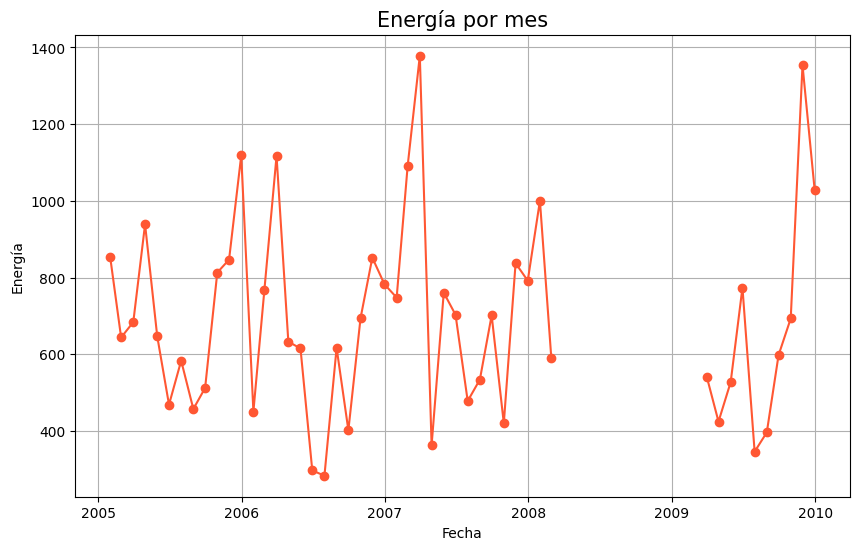

In [265]:
# Verifica si la columna 'Datetime' existe en el DataFrame
if 'Datetime' in wind_ava_sotavento.columns:
    # Convierte la columna 'Datetime' en tipo datetime y establece como índice
    wind_ava_sotavento["Datetime"] = pd.to_datetime(wind_ava_sotavento["Datetime"])
    wind_ava_sotavento.set_index('Datetime', inplace=True)

    # Dividir la columna 'Datetime' en dos nuevas columnas: 'Month' y 'Year'
    wind_ava_sotavento['Month'] = wind_ava_sotavento.index.month
    wind_ava_sotavento['Year'] = wind_ava_sotavento.index.year

    # Verifica si la columna 'Datetime' aún existe después de dividirla
    if 'Datetime' in wind_ava_sotavento.columns:
        # Eliminar la columna 'Datetime'
        wind_ava_sotavento.drop(columns=['Datetime'], inplace=True)
    else:
        print("La columna 'Datetime' ya ha sido eliminada.")

    # Ahora puedes realizar tu resampling y trazado
    date_por_mes = wind_ava_sotavento.resample('M').mean()

    plt.figure(figsize=(10, 6))
    plt.plot(date_por_mes.index, date_por_mes['Energy'], label='Energía', marker='o', color='#FF5733')
    plt.title('Energía por mes', fontsize=15)
    plt.xlabel('Fecha', fontsize=10)
    plt.ylabel('Energía', fontsize=10)
    plt.grid(True)
    plt.show()
else:
    print("La columna 'Datetime' no existe en el DataFrame.")


Mostramos el tipo de datos que hay:

In [266]:
print("\nTipos de variables:")
print(wind_ava_sotavento.dtypes)


Tipos de variables:
Vertical integral of temperature                     float64
Vertical integral of water vapour                    float64
Convective available potential energy                float64
Vertical integral of divergence of kinetic energy    float64
Leaf area index, low vegetation                      float64
Leaf area index, high vegetation                     float64
Neutral wind at 10 m u-component                     float64
Neutral wind at 10 m v-component                     float64
Surface pressure                                     float64
Soil temperature level 1                             float64
10 metre U wind component                            float64
10 metre V wind component                            float64
2 metre temperature                                  float64
Soil temperature level 2                             float64
Soil temperature level 3                             float64
Instantaneous eastward turbulent surface stress      float64
Ins

Mostramos los datos que faltan:

In [267]:
print("\nValores faltantes:")
print(wind_ava_sotavento.isnull().sum())


Valores faltantes:
Vertical integral of temperature                     0
Vertical integral of water vapour                    0
Convective available potential energy                0
Vertical integral of divergence of kinetic energy    0
Leaf area index, low vegetation                      0
Leaf area index, high vegetation                     0
Neutral wind at 10 m u-component                     0
Neutral wind at 10 m v-component                     0
Surface pressure                                     0
Soil temperature level 1                             0
10 metre U wind component                            0
10 metre V wind component                            0
2 metre temperature                                  0
Soil temperature level 2                             0
Soil temperature level 3                             0
Instantaneous eastward turbulent surface stress      0
Instantaneous northward turbulent surface            0
Soil temperature level 4                     

Eliminamos las columnas constantes en caso de existir:

In [270]:
const_cols = [col for col in wind_ava_sotavento.columns if wind_ava_sotavento[col].nunique() == 1]
if const_cols:
    wind_ava_sotavento.drop(const_cols, axis=1, inplace=True)
    print("\nColumnas constantes eliminadas:", const_cols)

Este código genera tres subgráficos utilizando `matplotlib` y `seaborn`, cada uno mostrando la distribución de la variable "Energía" de `wind_ava_sotavento` con diferentes transformaciones:

1. **Distribución original**: Muestra la distribución de la variable "Energía" sin ninguna transformación.
2. **Transformación raíz cuadrada**: Muestra la distribución de la raíz cuadrada de la variable "Energía".
3. **Transformación logarítmica**: Muestra la distribución del logaritmo natural de la variable "Energía".

Cada subgráfico utiliza un kernel density estimate (KDE) plot (`sns.kdeplot`) para visualizar la distribución de la variable y un rugplot (`sns.rugplot`) para mostrar la distribución de los puntos de datos a lo largo del eje x. El rugplot es una representación gráfica de la distribución de los datos.

El objetivo de este tipo de visualización es explorar cómo se distribuyen los datos y si alguna transformación puede hacer que la distribución sea más simétrica o normal, lo que puede ser útil para ciertos tipos de modelos de regresión.

Además, `fig.tight_layout()` se utiliza para ajustar automáticamente los espacios entre los subgráficos para que no se superpongan. Esto garantiza que los subgráficos sean legibles y estén bien distribuidos en la figura.

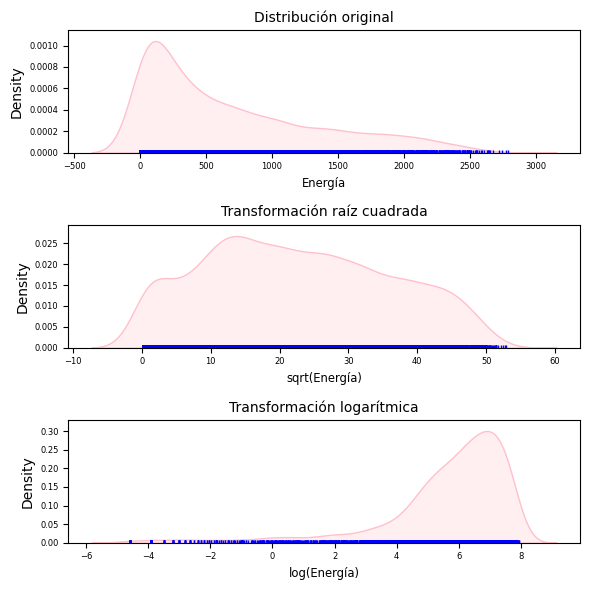

In [72]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(6, 6))
sns.kdeplot(wind_ava_sotavento['Energy'], fill = True, color = "pink", ax = axes[0])
sns.rugplot(wind_ava_sotavento['Energy'], color = "blue", ax = axes[0])
axes[0].set_title("Distribución original", fontsize = 'medium')
axes[0].set_xlabel('Energía', fontsize='small')
axes[0].tick_params(labelsize = 6)

sns.kdeplot(np.sqrt(wind_ava_sotavento['Energy']), fill = True, color = "pink", ax = axes[1])
sns.rugplot(np.sqrt(wind_ava_sotavento['Energy']), color = "blue", ax = axes[1])
axes[1].set_title("Transformación raíz cuadrada", fontsize = 'medium')
axes[1].set_xlabel('sqrt(Energía)', fontsize='small')
axes[1].tick_params(labelsize = 6)

sns.kdeplot(np.log(wind_ava_sotavento['Energy']), fill = True, color = "pink", ax = axes[2])
sns.rugplot(np.log(wind_ava_sotavento['Energy']), color = "blue", ax = axes[2])
axes[2].set_title("Transformación logarítmica", fontsize = 'medium')
axes[2].set_xlabel('log(Energía)', fontsize='small')
axes[2].tick_params(labelsize = 6)

fig.tight_layout()

El código calcula la matriz de correlación entre las correlaciones entre pares de variables en el conjunto de datos `wind_ava_sotavento`. Luego, utilizamos `sns.heatmap` de Seaborn para visualizar esta matriz de correlación como un mapa de calor.

Aquí está lo que hace paso a paso:

1. `correlaciones = wind_ava_sotavento.corr()`: Calcula la matriz de correlación entre las variables en `wind_ava_sotavento`. Esta matriz es cuadrada y simétrica, donde cada entrada indica la correlación entre dos variables.

2. `plt.figure(figsize=(20, 16))`: Crea una nueva figura de matplotlib con el tamaño especificado (20 unidades de ancho y 16 unidades de alto). Esto establece el tamaño de la figura en la que se mostrará el mapa de calor.

3. `sns.heatmap(correlaciones.corr().abs(), fmt=".2f", annot=True, cmap="BLues")`: Crea un mapa de calor de la matriz de correlación. Los parámetros `fmt=".2f"` y `annot=True` se utilizan para mostrar los valores de correlación en el mapa de calor con dos decimales y para anotar los valores en las celdas del mapa de calor, respectivamente. El parámetro `cmap="Blues"` especifica el mapa de colores que se utilizará para representar los valores de correlación.

El objetivo de este mapa el observar una posible correlación alta entre dos variables, y poder prescindir de una de ellas.


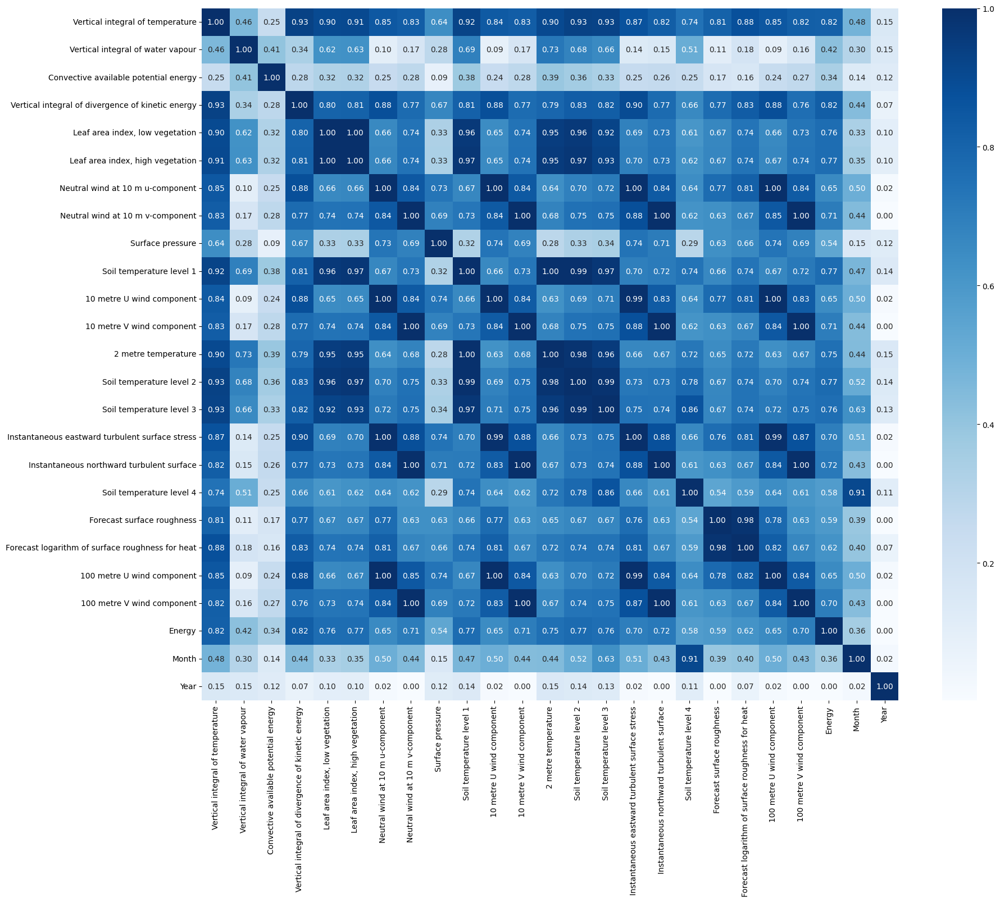

In [275]:
correlaciones = wind_ava_sotavento.corr()
plt.figure(figsize=(20, 16))
plot = sns.heatmap(correlaciones.corr().abs(), fmt=".2f", annot=True, cmap="Blues")

A continuación:

Este código crea un conjunto de gráficos de dispersión para visualizar las relaciones entre una columna específica del conjunto de datos (`columna_interes`) y todas las demás columnas en el conjunto de datos `wind_ava_sotavento`.

Aquí está lo que hace paso a paso:

1. `columna_interes = 'Vertical integral of temperature'`: Selecciona la columna específica del conjunto de datos que se utilizará como la columna de interés para comparar con todas las demás columnas.

2. `fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))`: Crea una figura y un conjunto de subgráficos con una cuadrícula de 6 filas y 5 columnas. Esto creará un total de 30 subgráficos, cada uno para una columna diferente en el conjunto de datos `wind_ava_sotavento`. La figura tiene un tamaño de 24 pulgadas de ancho y 30 pulgadas de alto.

3. `axes = axes.flat`: Aplanar el conjunto de subgráficos en una lista plana para facilitar la iteración sobre ellos.

4. `for i, columna in enumerate(wind_ava_sotavento.columns):`: Itera sobre cada columna en el conjunto de datos `wind_ava_sotavento`. El bucle `for` recorre todas las columnas y su índice `i`.

5. `sns.scatterplot(x=wind_ava_sotavento[columna_interes], y=wind_ava_sotavento[columna], color='#a0f207', ax=axes[i])`: Para cada columna en el conjunto de datos, crea un gráfico de dispersión (`scatterplot`) que compara los valores de la columna de interés (`columna_interes`) en el eje x y los valores de la columna actual en el eje y. El color de los puntos del gráfico de dispersión se establece en `'#a0f207'`.

6. `axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')`: Establece el título de cada subgráfico para indicar qué columnas se están comparando.

7. `axes[i].set_xlabel(columna_interes)`: Establece la etiqueta del eje x para indicar la columna de interés.

8. `axes[i].set_ylabel(columna)`: Establece la etiqueta del eje y para indicar la columna actual.

9. `plt.tight_layout()`: Ajusta automáticamente el diseño de los subgráficos para evitar que se superpongan.

10. `plt.show()`: Muestra la figura con los gráficos de dispersión.

En resumen, este código crea un conjunto de gráficos de dispersión para explorar visualmente las relaciones entre una columna específica del conjunto de datos y todas las demás columnas. Cada gráfico de dispersión compara la columna de interés con una columna diferente en el conjunto de datos.

Se ha realizado un conjunto de graficos de disperacios para las 22 varaibles, sin emebargo al final del todo se observan en grande las 3 de mayor correlación que hemos eliminado.

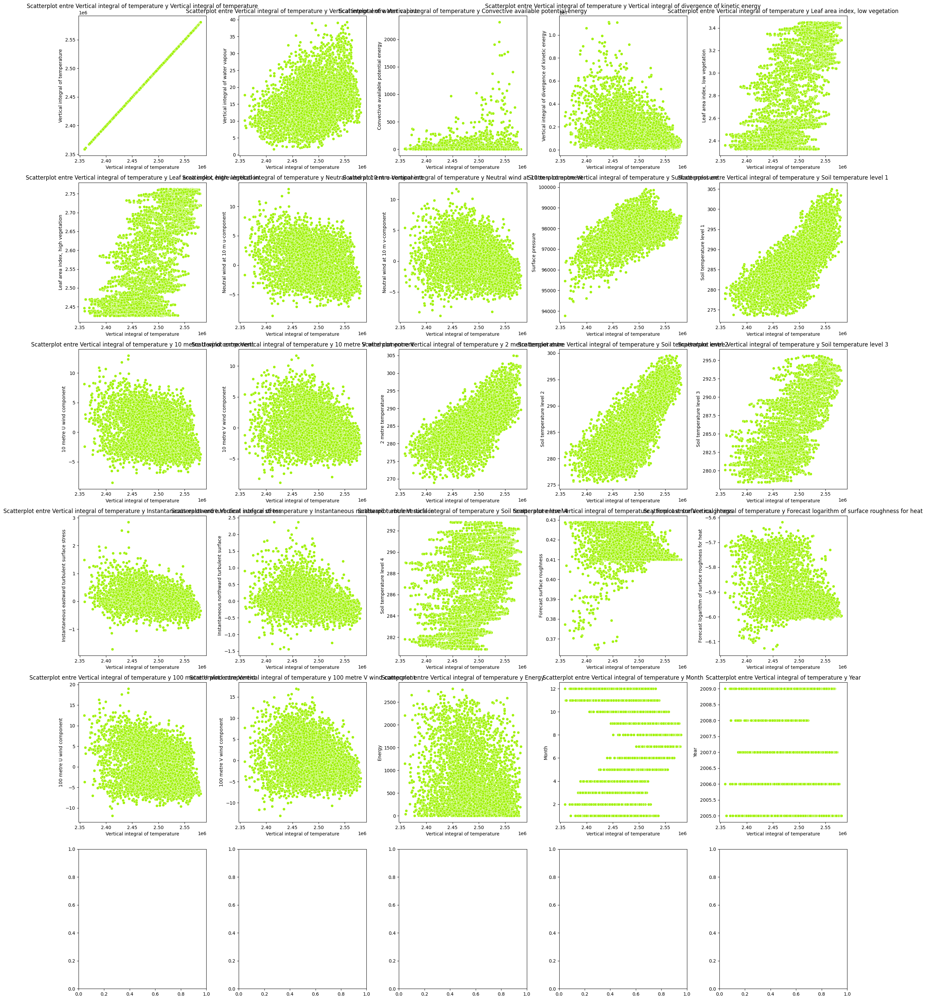

In [ ]:
# Columna de interés
columna_interes = 'Vertical integral of temperature'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

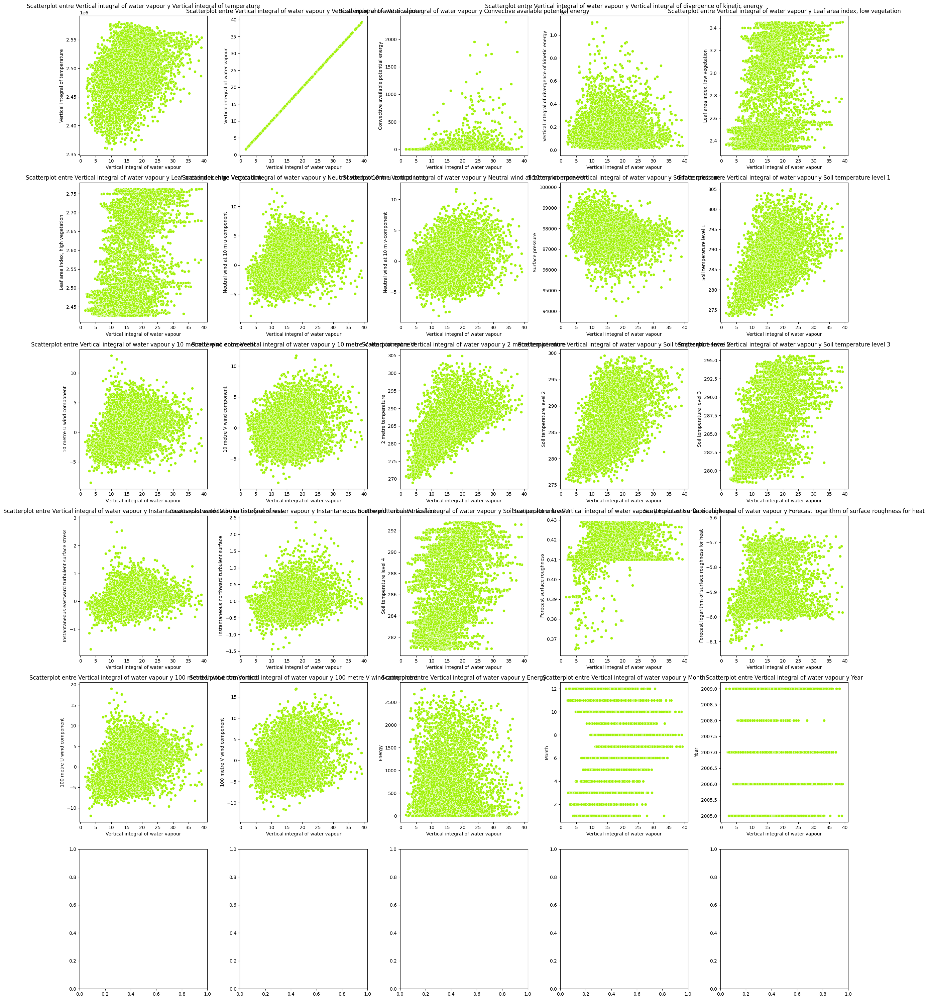

In [ ]:
# Columna de interés
columna_interes = 'Vertical integral of water vapour'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

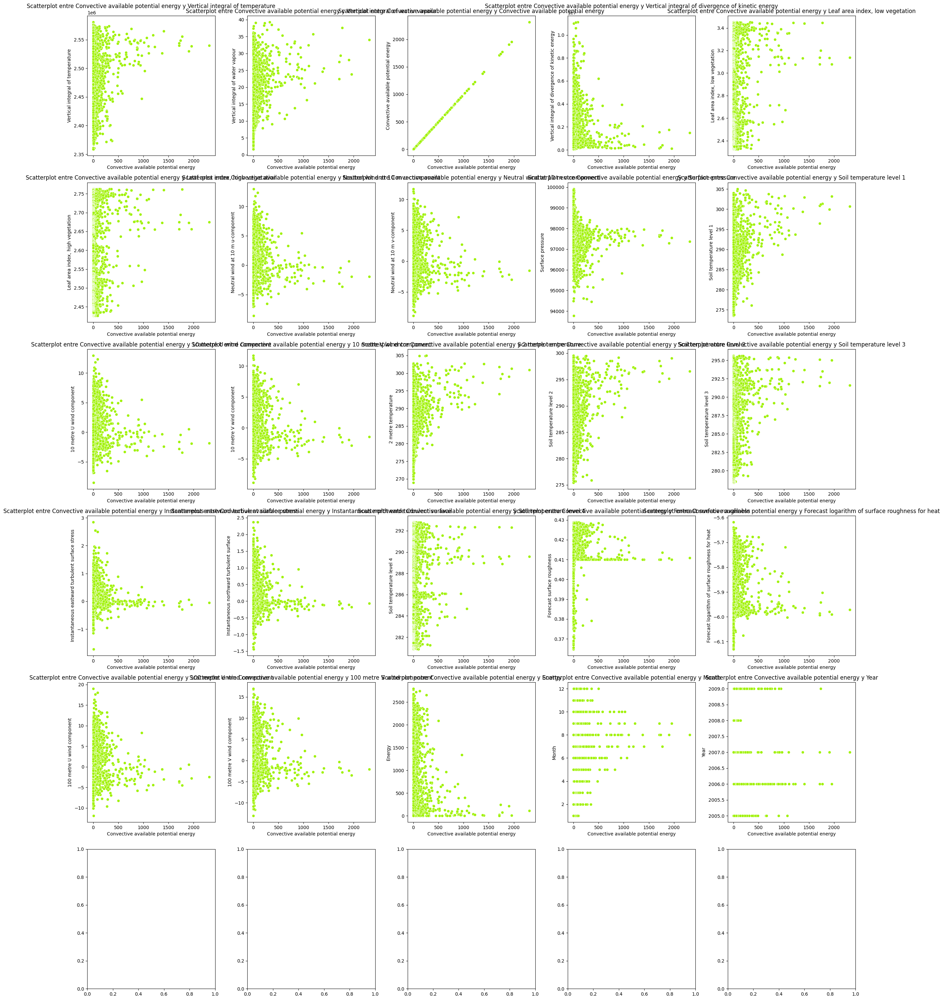

In [ ]:
# Columna de interés
columna_interes = 'Convective available potential energy'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

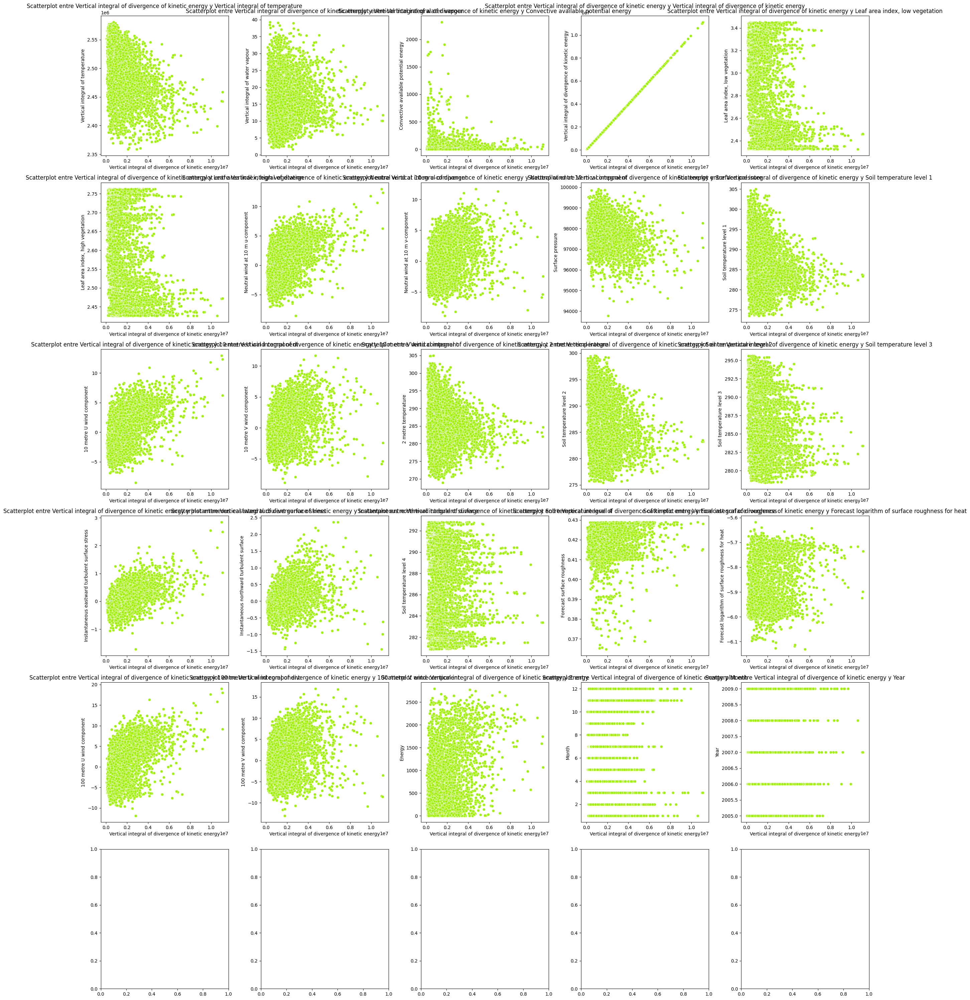

In [ ]:
# Columna de interés
columna_interes = 'Vertical integral of divergence of kinetic energy'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

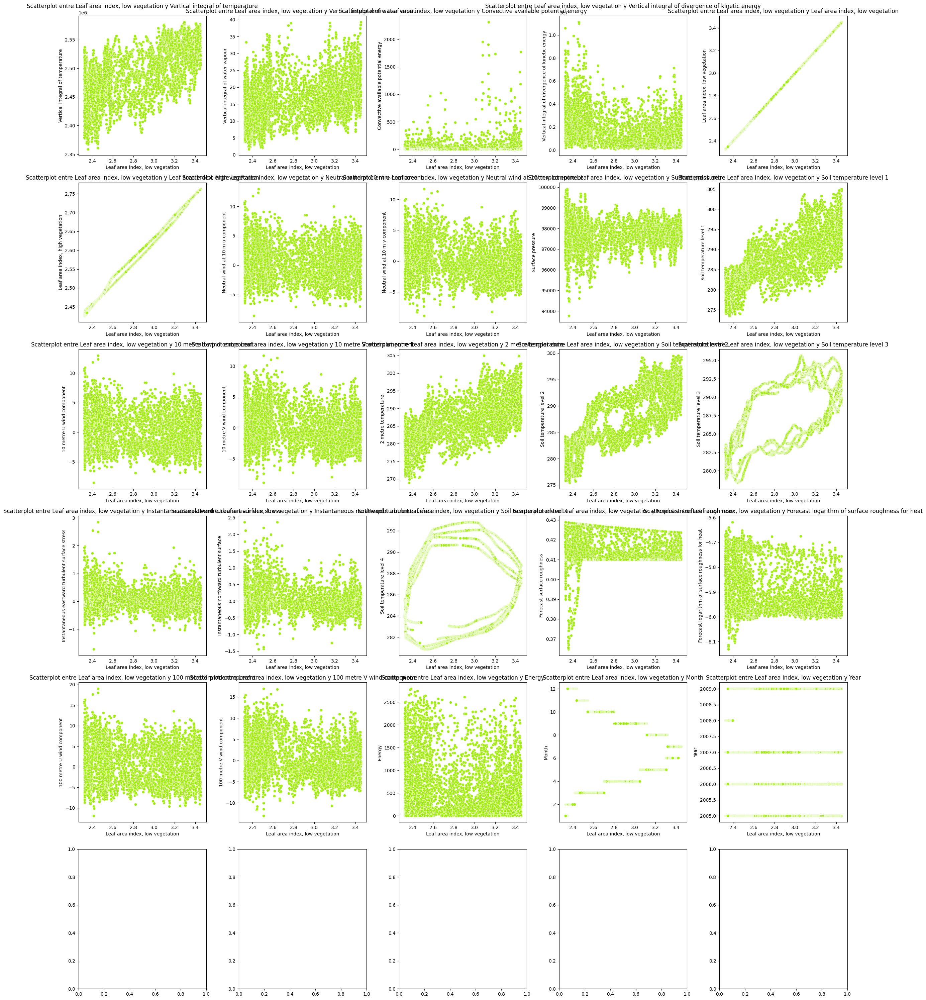

In [ ]:
# Columna de interés
columna_interes = 'Leaf area index, low vegetation'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

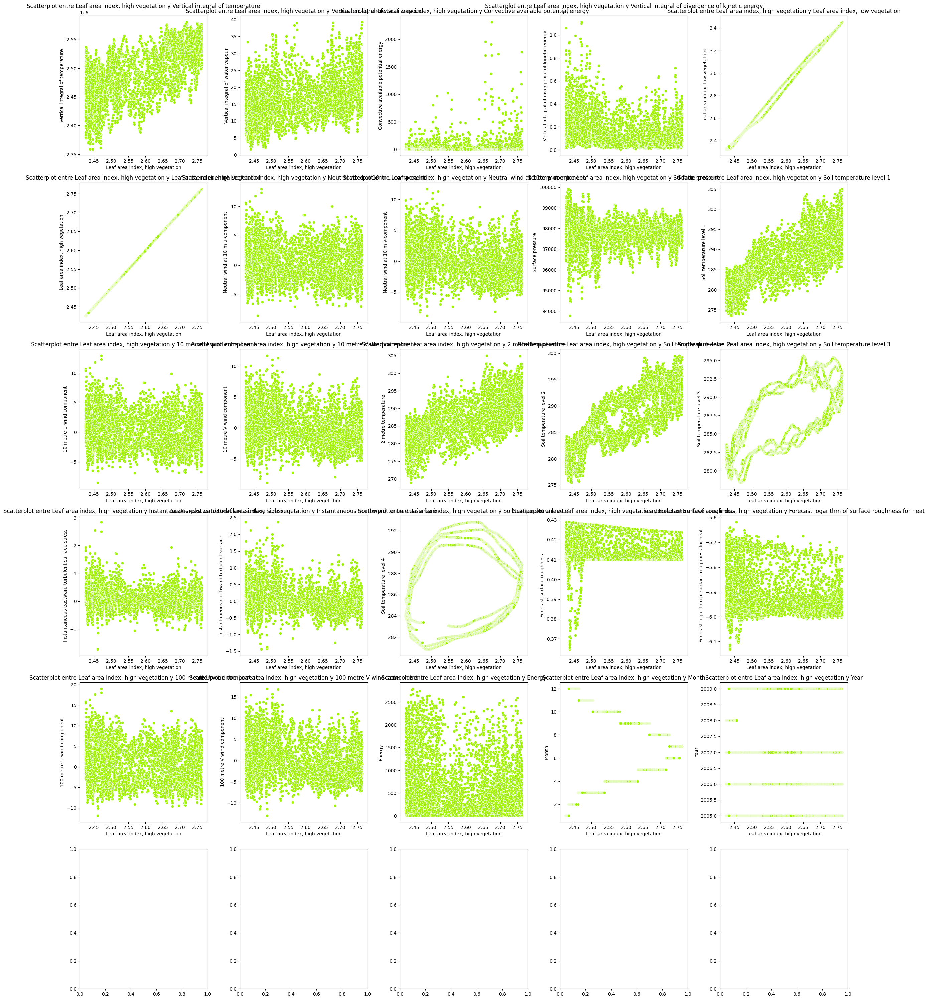

In [ ]:
# Columna de interés
columna_interes = 'Leaf area index, high vegetation'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

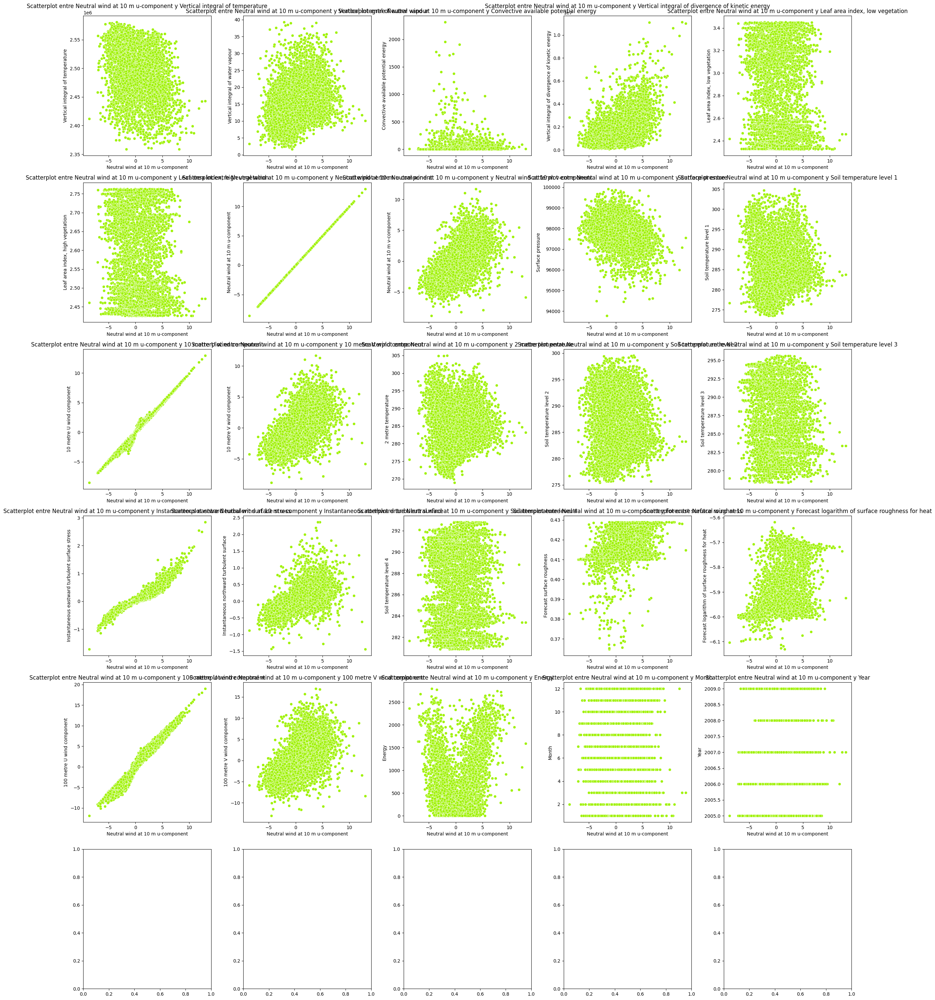

In [ ]:
# Columna de interés
columna_interes = 'Neutral wind at 10 m u-component'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

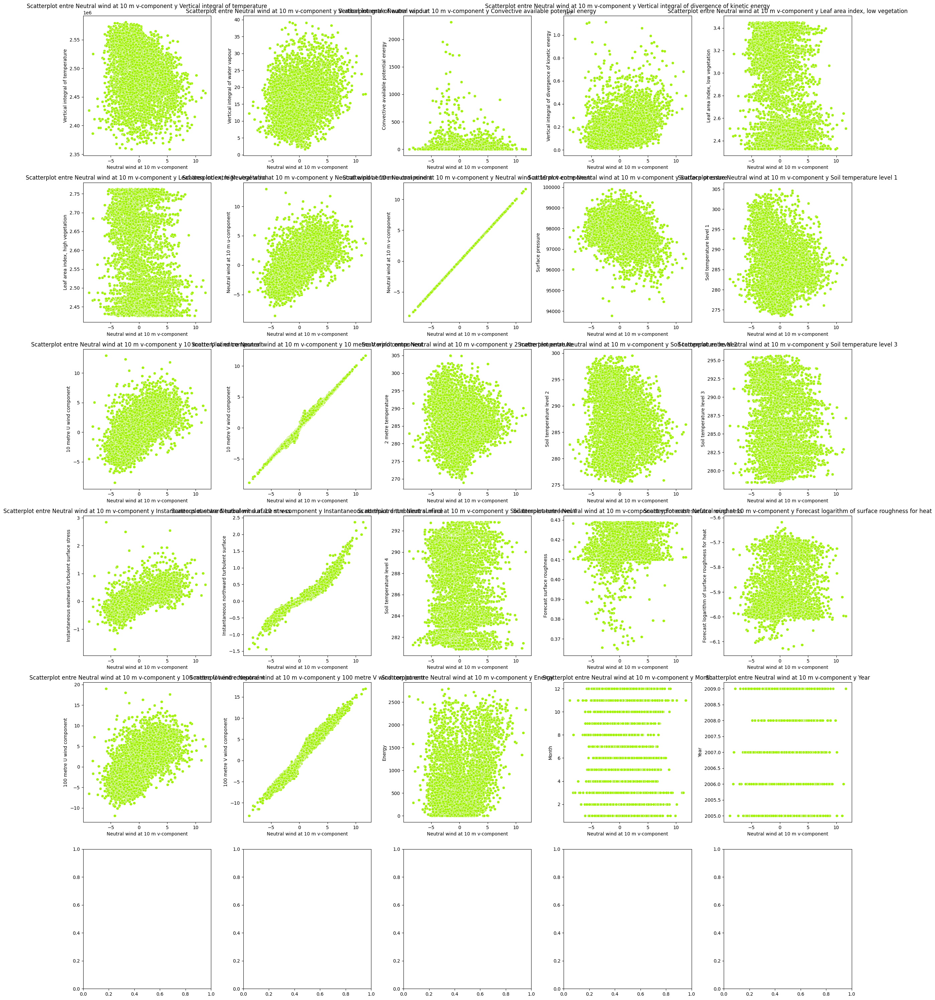

In [ ]:
# Columna de interés
columna_interes = 'Neutral wind at 10 m v-component'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

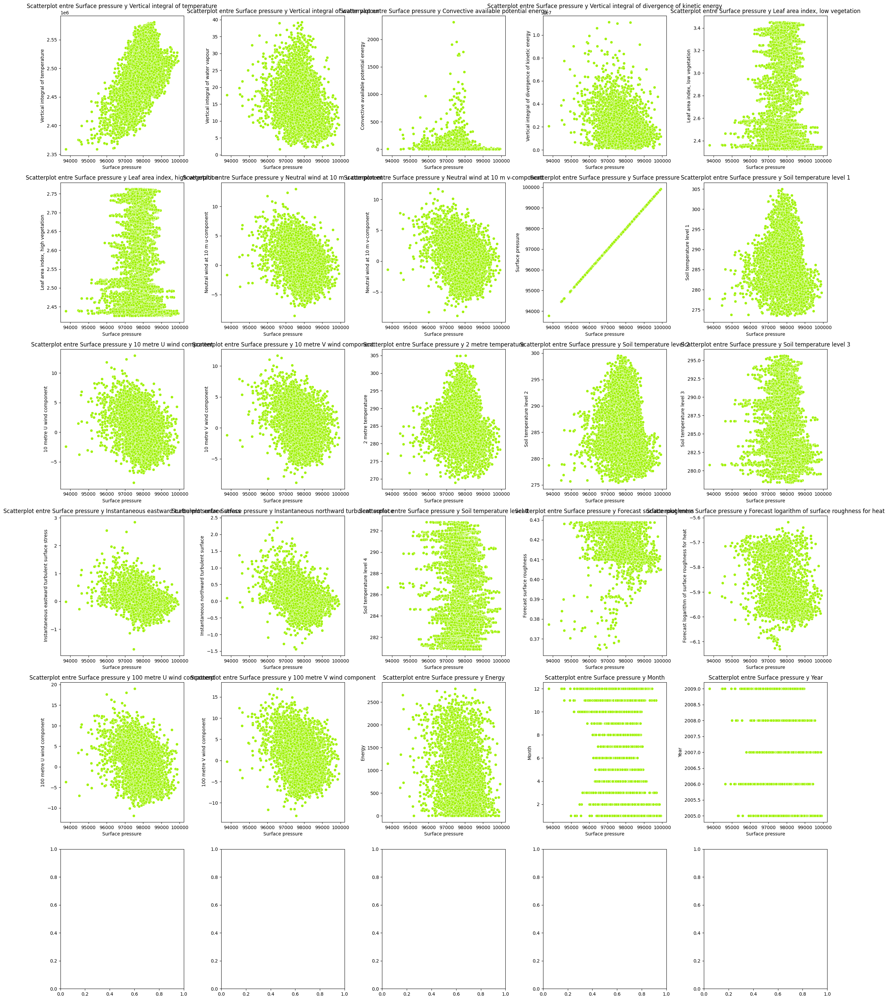

In [ ]:
# Columna de interés
columna_interes = 'Surface pressure'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

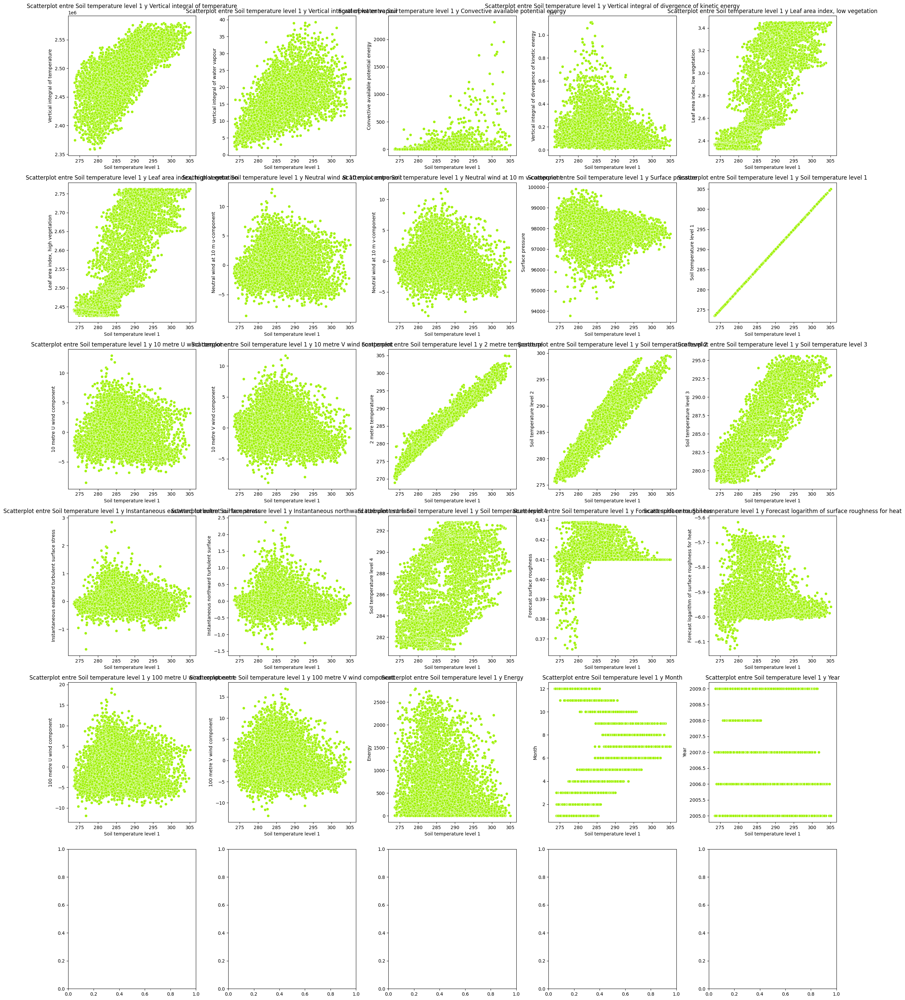

In [ ]:
# Columna de interés
columna_interes = 'Soil temperature level 1'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

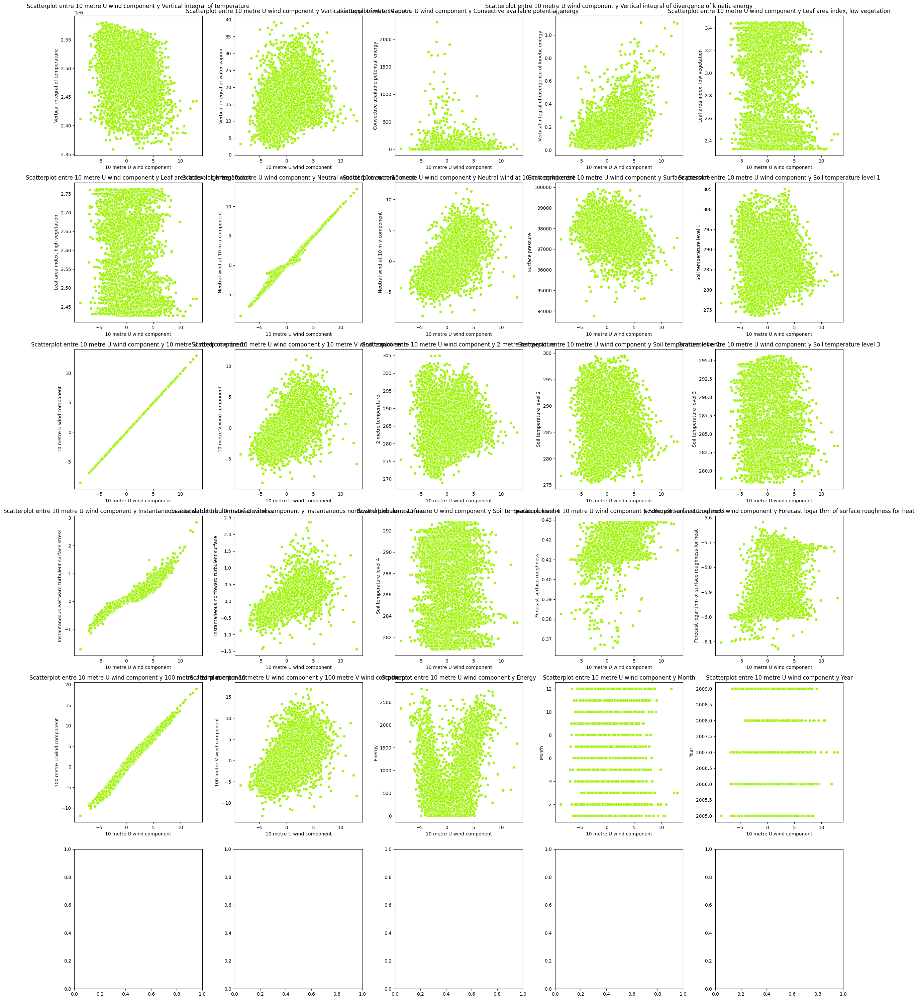

In [ ]:
# Columna de interés
columna_interes = '10 metre U wind component'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

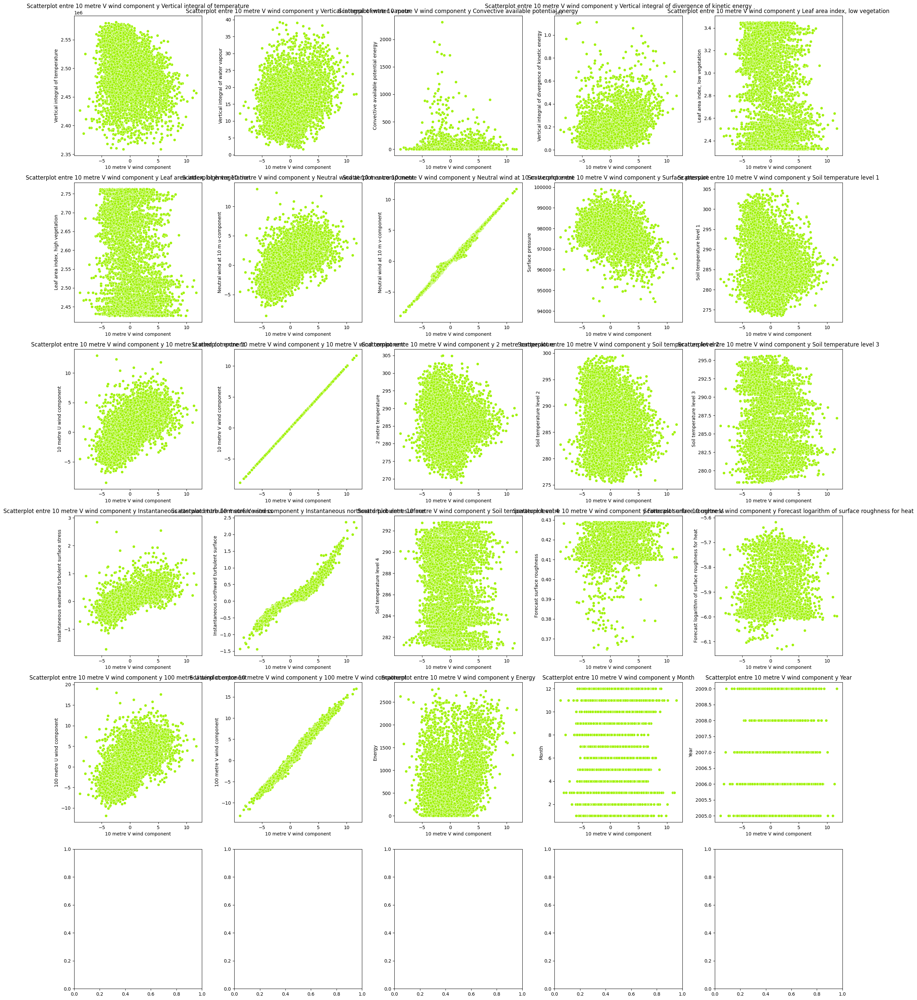

In [ ]:
# Columna de interés
columna_interes = '10 metre V wind component'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

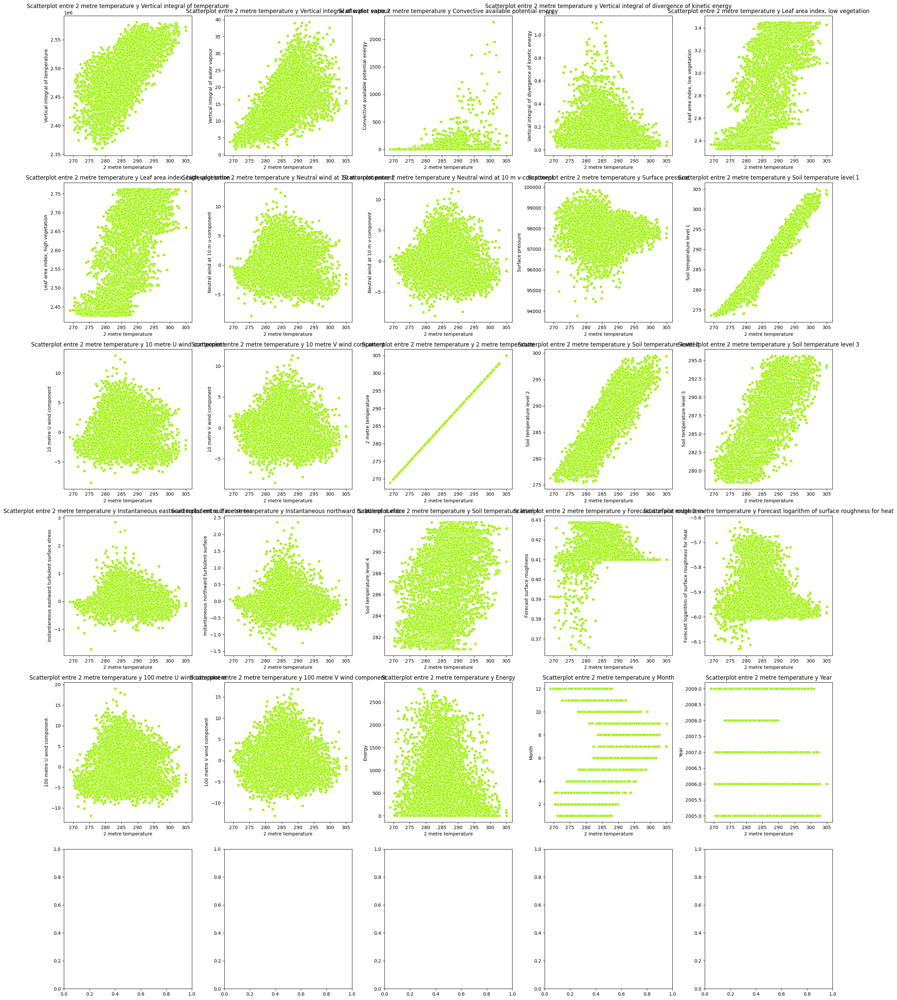

In [ ]:
# Columna de interés
columna_interes = '2 metre temperature'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

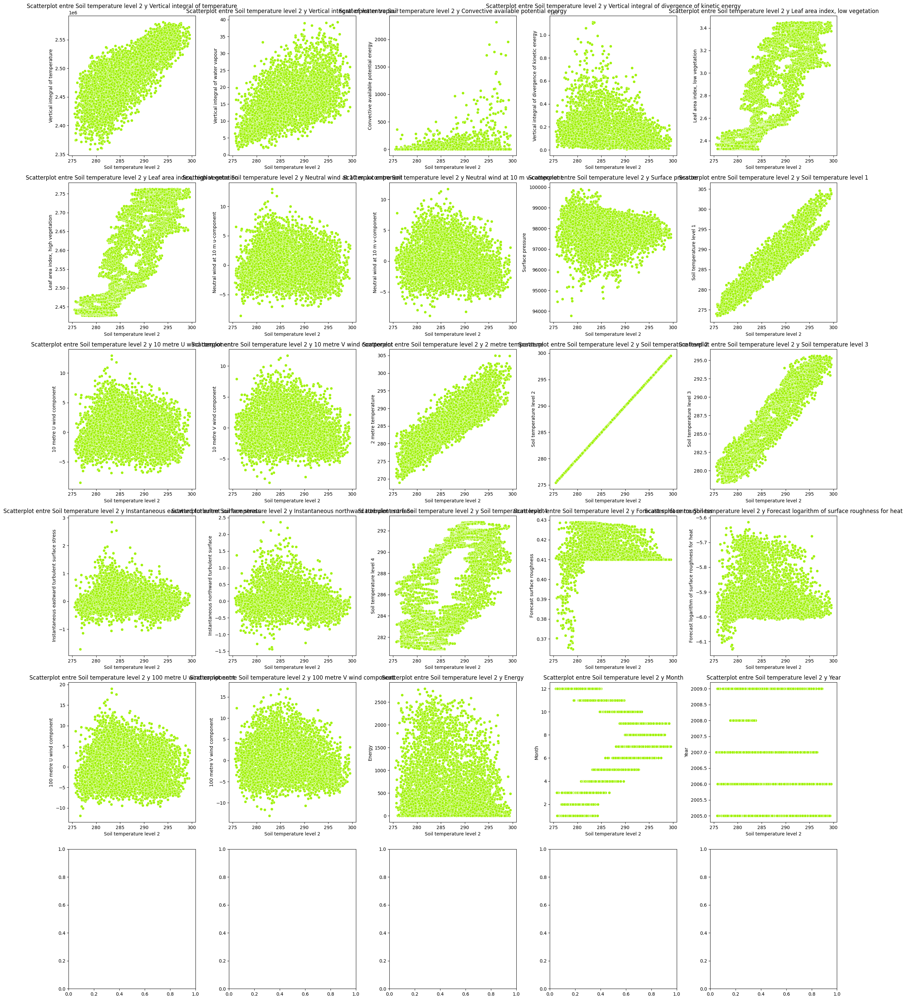

In [ ]:
# Columna de interés
columna_interes = 'Soil temperature level 2'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

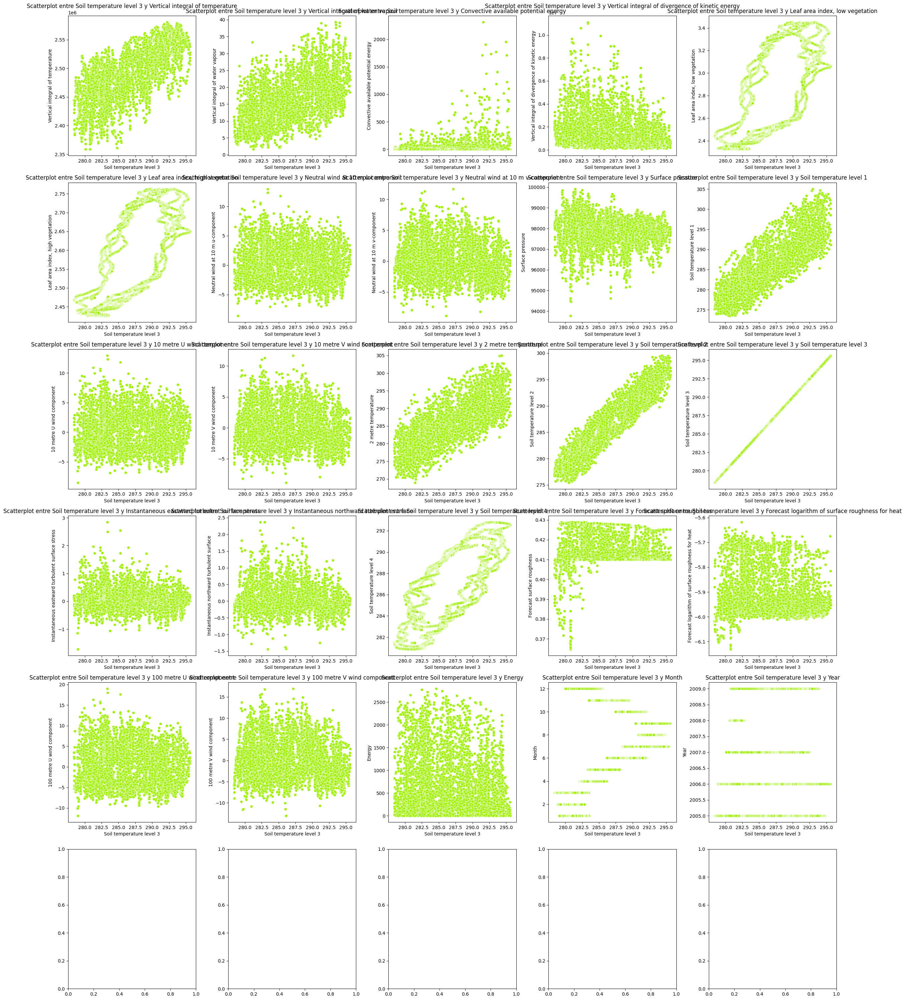

In [ ]:
# Columna de interés
columna_interes = 'Soil temperature level 3'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

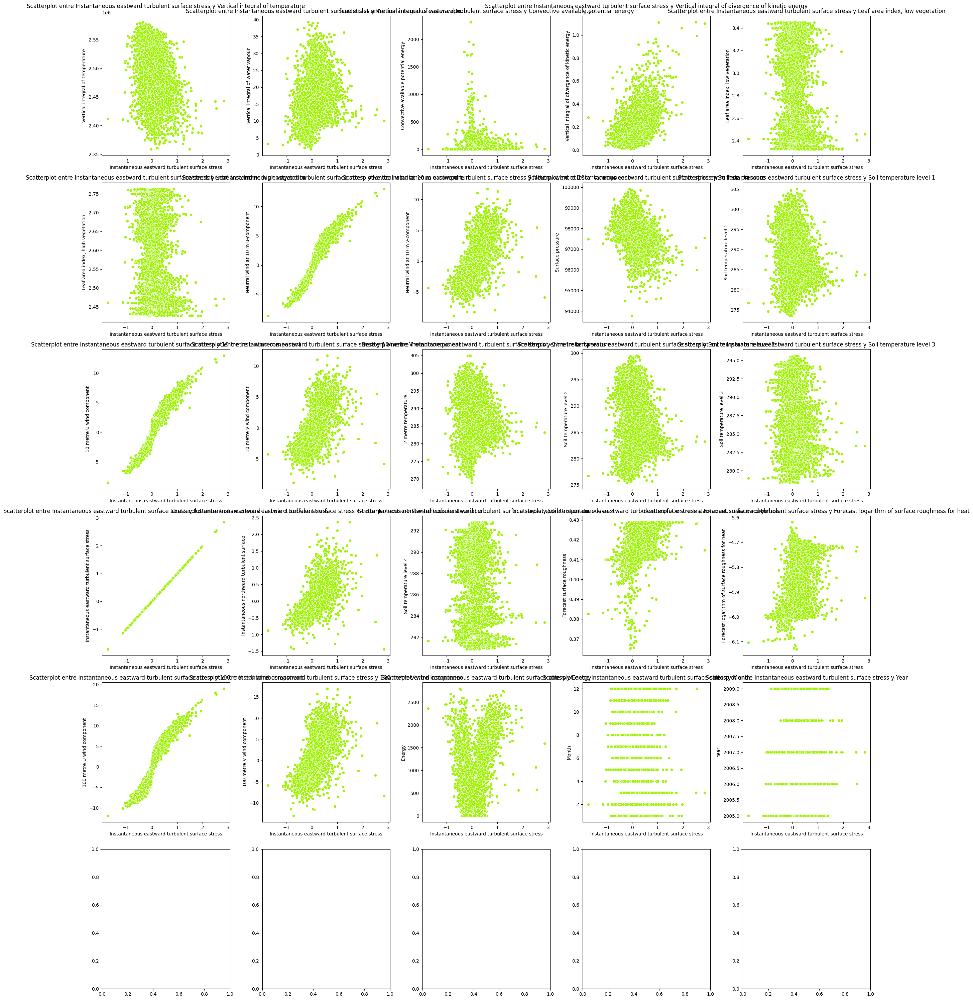

In [ ]:
# Columna de interés
columna_interes = 'Instantaneous eastward turbulent surface stress'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

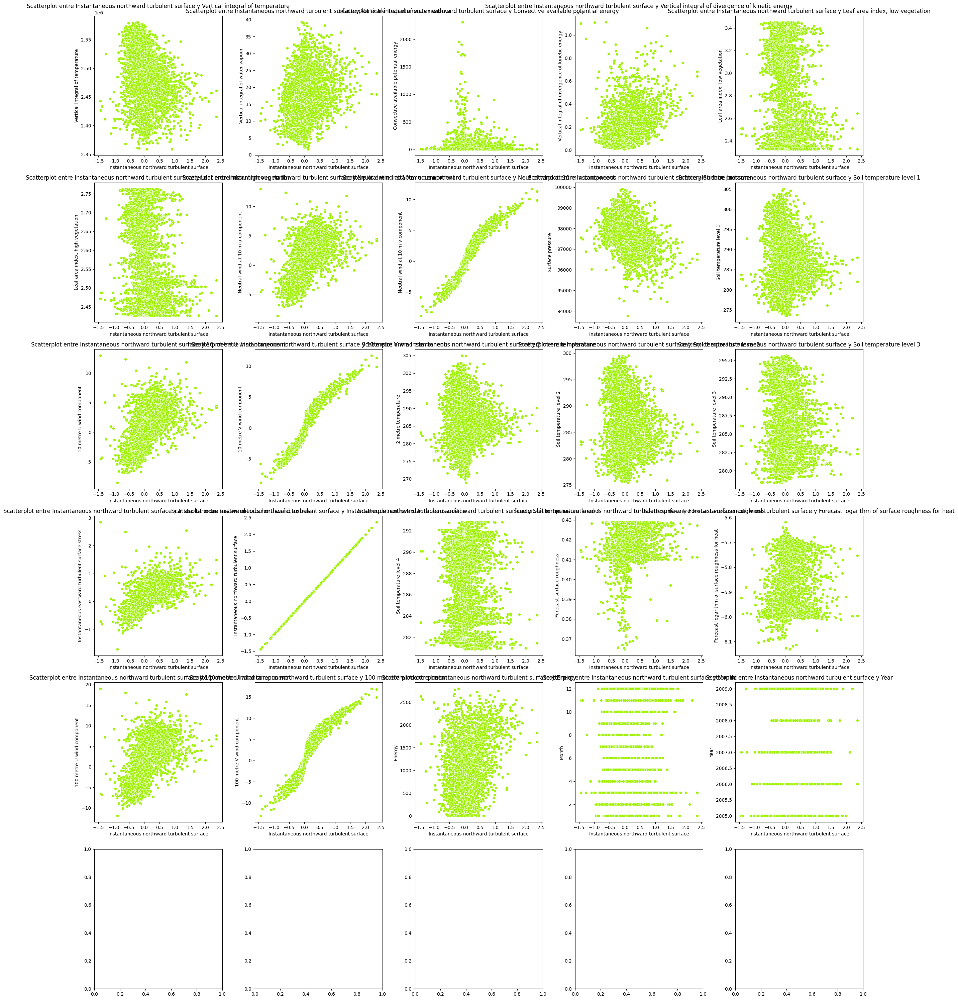

In [ ]:
# Columna de interés
columna_interes = 'Instantaneous northward turbulent surface'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

In [ ]:
# Columna de interés
columna_interes = 'Soil temperature level 4'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

In [ ]:
# Columna de interés
columna_interes = 'Forecast surface roughness'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

In [ ]:
# Columna de interés
columna_interes = 'Forecast logarithm of surface roughness for heat'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

In [ ]:
# Columna de interés
columna_interes = '100 metre U wind component'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

In [ ]:
# Columna de interés
columna_interes = '100 metre V wind component'

# Crear el gráfico de regresión
fig, axes = plt.subplots(nrows=6, ncols=5, figsize=(24, 30))
axes = axes.flat

for i, columna in enumerate(wind_ava_sotavento.columns):
    sns.scatterplot(x=wind_ava_sotavento[columna_interes],
                    y=wind_ava_sotavento[columna],
                    color='#a0f207',
                    ax=axes[i])
    axes[i].set_title(f'Scatterplot entre {columna_interes} y {columna}')
    axes[i].set_xlabel(columna_interes)
    axes[i].set_ylabel(columna)

plt.tight_layout()
plt.show()

Finalmente, en esta sección mostramos los 3 pares de variables que guardan una alta correlación:


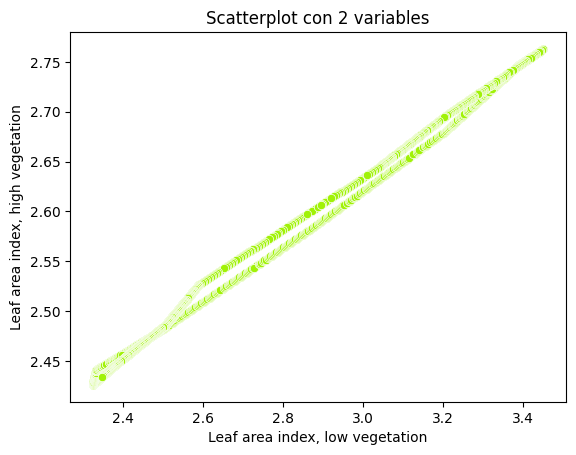

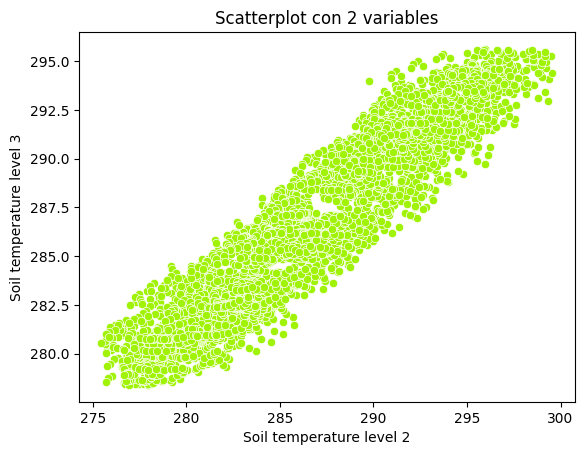

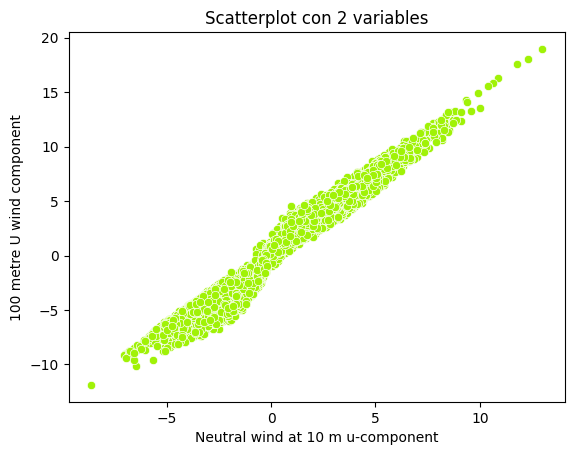

In [ ]:
sns.scatterplot(x=wind_ava_sotavento['Leaf area index, low vegetation'], 
                y=wind_ava_sotavento['Leaf area index, high vegetation'], 
                color='#a0f207')
plt.title('Scatterplot con 2 variables')
plt.xlabel('Leaf area index, low vegetation')
plt.ylabel('Leaf area index, high vegetation')
plt.show()

sns.scatterplot(x=wind_ava_sotavento['Soil temperature level 2'], 
                y=wind_ava_sotavento['Soil temperature level 3'], 
                color='#a0f207')
plt.title('Scatterplot con 2 variables')
plt.xlabel('Soil temperature level 2')
plt.ylabel('Soil temperature level 3')
plt.show()

sns.scatterplot(x=wind_ava_sotavento['Neutral wind at 10 m u-component'], 
                y=wind_ava_sotavento['100 metre U wind component'], 
                color='#a0f207')
plt.title('Scatterplot con 2 variables')
plt.xlabel('Neutral wind at 10 m u-component')
plt.ylabel('100 metre U wind component')
plt.show()

Procedemos a su eliminación:

In [277]:
wind_ava_sotavento.drop(columns=['Leaf area index, low vegetation'], inplace=True)
wind_ava_sotavento.drop(columns=['Soil temperature level 2'], inplace=True)
wind_ava_sotavento.drop(columns=['Neutral wind at 10 m u-component'], inplace=True)

Y cargamos otra vez el heatmap:

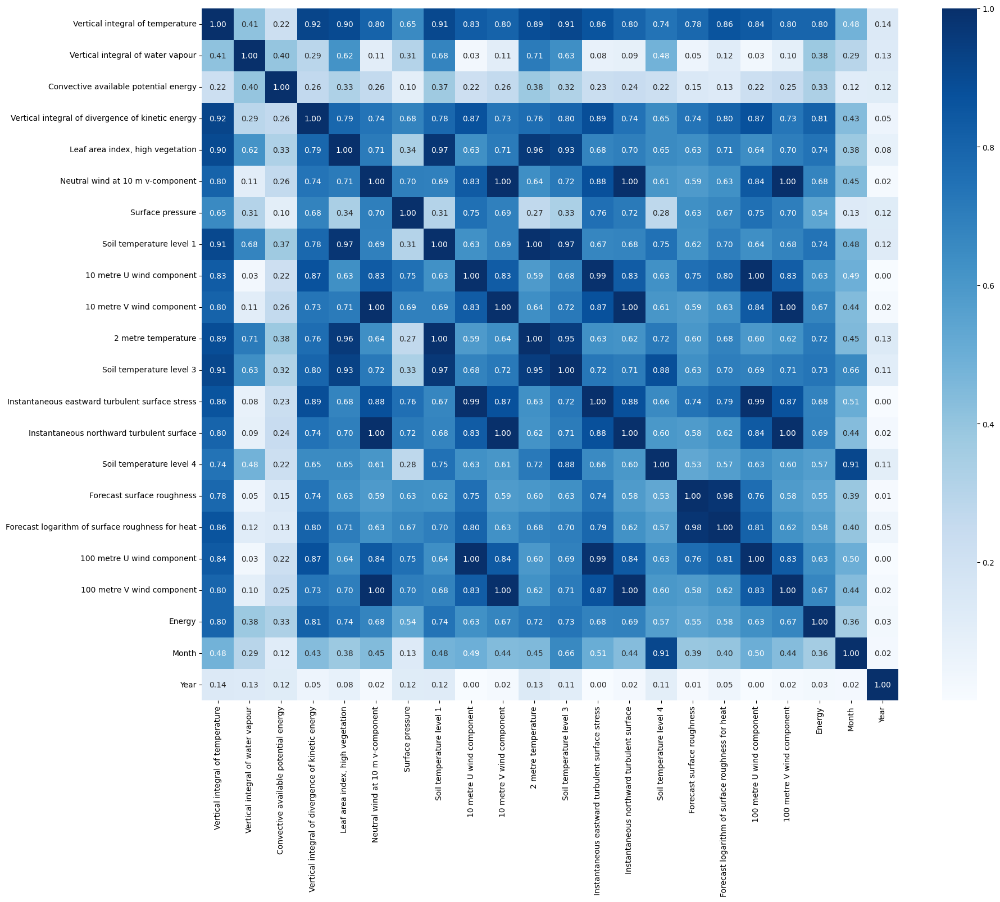

In [278]:
correlaciones = wind_ava_sotavento.corr()
plt.figure(figsize=(20, 16))
plot = sns.heatmap(correlaciones.corr().abs(), fmt=".2f", annot=True, cmap="Blues")

In [ ]:
wind_ava_sotavento.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4748 entries, 2005-01-02 18:00:00 to 2009-12-31 18:00:00
Data columns (total 22 columns):
 #   Column                                             Non-Null Count  Dtype  
---  ------                                             --------------  -----  
 0   Vertical integral of temperature                   4748 non-null   float64
 1   Vertical integral of water vapour                  4748 non-null   float64
 2   Convective available potential energy              4748 non-null   float64
 3   Vertical integral of divergence of kinetic energy  4748 non-null   float64
 4   Leaf area index, high vegetation                   4748 non-null   float64
 5   Neutral wind at 10 m v-component                   4748 non-null   float64
 6   Surface pressure                                   4748 non-null   float64
 7   Soil temperature level 1                           4748 non-null   float64
 8   10 metre U wind component                          4

HEMOS FINALIZADO EL EDA

# 2. **EVALUACIÓN.** OUTER / INNER

In [7]:
wind_ava = pd.read_csv('wind_ava.csv.gz', compression="gzip", sep=",")

In [8]:
sotavento_columns = [col for col in wind_ava.columns if ".13" in col]
sotavento_columns.insert(0, "datetime")
sotavento_columns.append("energy")
wind_ava_sotavento = wind_ava[sotavento_columns]

In [9]:
wind_ava_sotavento = wind_ava_sotavento.rename(columns = {
    "energy": "Energy", 
    "datetime": "Datetime", 
    "p54.162.13": "Vertical integral of temperature", 
    "p55.162.13": "Vertical integral of water vapour", 
    "cape.13": "Convective available potential energy", 
    "p59.162.13": "Vertical integral of divergence of kinetic energy", 
    "lai_lv.13": "Leaf area index, low vegetation", 
    "lai_hv.13": "Leaf area index, high vegetation", 
    "u10n.13": "Neutral wind at 10 m u-component", 
    "v10n.13": "Neutral wind at 10 m v-component", 
    "sp.13": "Surface pressure",
    "stl1.13": "Soil temperature level 1",
    "u10.13": "10 metre U wind component",
    "v10.13": "10 metre V wind component",
    "t2m.13": "2 metre temperature", 
    "stl2.13": "Soil temperature level 2", 
    "stl3.13": "Soil temperature level 3", 
    "iews.13": "Instantaneous eastward turbulent surface stress",
    "inss.13": "Instantaneous northward turbulent surface", 
    "stl4.13": "Soil temperature level 4", 
    "fsr.13": "Forecast surface roughness", 
    "flsr.13": "Forecast logarithm of surface roughness for heat",
    "u100.13": "100 metre U wind component",
    "v100.13": "100 metre V wind component", })
wind_ava_sotavento.head()

,Datetime,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, low vegetation","Leaf area index, high vegetation",Neutral wind at 10 m u-component,Neutral wind at 10 m v-component,Surface pressure,...,Soil temperature level 2,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
0,2005-01-02 18:00:00,2.510824e+06,9.186295,13.527577,1.386937e+06,2.344111,2.432983,-0.757587,-1.922799,99846.319914,...,281.042026,281.462478,-0.057958,-0.138650,284.684755,0.404731,-5.927092,-1.780562,-4.443617,402.71
1,2005-01-03 00:00:00,2.513173e+06,8.849569,6.896412,1.153526e+06,2.343719,2.432838,-1.412620,-1.403011,99917.733093,...,280.747406,281.486541,-0.103576,-0.083050,284.667948,0.404920,-5.913881,-3.743344,-3.129469,696.80
2,2005-01-03 06:00:00,2.509627e+06,7.924080,4.774439,1.098754e+06,2.343300,2.432704,-2.290185,-0.754580,99764.378681,...,280.114863,281.487095,-0.165721,-0.036241,284.651914,0.405704,-5.908272,-5.097203,-1.157748,1591.15
3,2005-01-03 12:00:00,2.510571e+06,6.922709,0.000000,1.076021e+06,2.342830,2.432514,-3.497855,1.271028,99672.670459,...,279.991138,281.472435,-0.275550,0.098192,284.636266,0.403967,-5.961995,-4.500835,1.502478,1338.62
4,2005-01-03 18:00:00,2.505664e+06,6.646282,0.000000,1.070830e+06,2.342437,2.432369,-0.971249,0.553060,99372.811211,...,280.576898,281.473265,-0.056553,0.041844,284.620232,0.403808,-5.987860,-3.392324,2.131114,562.50


In [10]:
wind_ava_sotavento.drop(columns=['Leaf area index, low vegetation'], inplace=True)
wind_ava_sotavento.drop(columns=['Soil temperature level 2'], inplace=True)
wind_ava_sotavento.drop(columns=['Neutral wind at 10 m u-component'], inplace=True)

Lo primero que haremos después de mostrar los datos con los que trabajamos será el entrenamiento de los modelos para observar qué modelo es mejor.
Además, sabemos que debido a la categoría de los datos los métodos que utilizaremos son del tipo de regresión, esto es debido a que a variable de salida se corresponde con valores númericos.

Parael entrenamiento de datos, tendremos que obtener los datos que vamos a utilizar para su entrenamiento, para ellos lo primero que haremos es dividir los datos por años:

In [11]:
import pandas as pd

# Copia del dataframe original
dataset_sotavento_copy = wind_ava_sotavento.copy()

# Convertir 'Datetime' a tipo datetime
dataset_sotavento_copy["Datetime"] = pd.to_datetime(dataset_sotavento_copy["Datetime"])

# Crear la columna 'Year'
dataset_sotavento_copy['Year'] = dataset_sotavento_copy['Datetime'].dt.year
# Crear la columna 'Month'
dataset_sotavento_copy['Month'] = dataset_sotavento_copy['Datetime'].dt.month

# Separar los datos por año
dfs_per_year = {}
years = [2005, 2006, 2007, 2008, 2009]
for year in years:
    dfs_per_year[year] = dataset_sotavento_copy[dataset_sotavento_copy["Year"] == year].copy()  # Copia del DataFrame

# Eliminar las columnas 'Datetime' y 'Year'
for df in dfs_per_year.values():
    df.drop(columns=['Datetime', 'Year', 'Month'], inplace=True)

# Imprimir los datos por años
for year, df in dfs_per_year.items():
    print(f"Año {year}")
    display(df.describe())



Año 2005


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, high vegetation",Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,10 metre U wind component,10 metre V wind component,2 metre temperature,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,1.256000e+03,1256.000000,1256.000000,1.256000e+03,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000,1256.000000
mean,2.490163e+06,14.974897,18.695572,1.637962e+06,2.573296,-0.154809,97929.057902,286.423128,0.000947,-0.118305,285.374838,286.451280,0.030567,0.011607,286.474023,0.412472,-5.920952,-0.044670,-0.119119,718.697078
std,4.565748e+04,6.264040,64.414358,1.251384e+06,0.115452,3.057194,692.248988,6.841428,3.062128,3.110474,6.566747,4.987448,0.342333,0.375015,3.884430,0.007755,0.088826,4.706345,4.781159,669.357880
min,2.360347e+06,2.455159,0.000000,5.610341e+04,2.425866,-8.867441,95326.740861,273.558807,-8.483701,-8.845246,270.312454,278.389271,-1.714897,-1.430244,280.875389,0.371716,-6.103557,-11.879053,-13.043453,0.010000
25%,2.458392e+06,10.162259,0.000000,7.261740e+05,2.464016,-2.426593,97472.656174,280.963956,-2.462841,-2.478077,280.672161,282.135770,-0.153119,-0.189803,282.698597,0.410021,-5.980925,-4.058791,-3.825583,173.177500
50%,2.489520e+06,14.550201,0.530493,1.292338e+06,2.544660,-0.416457,97934.146407,285.764337,-0.559426,-0.499019,284.984504,285.694741,-0.011060,-0.019718,286.321687,0.410461,-5.957047,-0.610321,-0.887834,515.745000
75%,2.526095e+06,19.050102,11.386658,2.216000e+06,2.686188,1.815414,98396.112305,291.302545,2.263881,1.955084,289.705318,291.375789,0.193661,0.155802,290.397982,0.414842,-5.884128,3.773504,3.182208,1098.310000
max,2.580387e+06,39.085819,1065.571442,7.256923e+06,2.762992,11.029826,99917.733093,305.043177,8.444371,11.037358,302.788510,294.813820,1.385272,1.996405,292.107406,0.428914,-5.642137,12.437051,15.708148,2774.890000


Año 2006


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, high vegetation",Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,10 metre U wind component,10 metre V wind component,2 metre temperature,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,1.272000e+03,1272.000000,1272.000000,1.272000e+03,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000,1272.000000
mean,2.487344e+06,16.758575,49.004104,1.587265e+06,2.576766,0.319202,97705.717291,287.218516,0.393799,0.378408,286.184102,287.021828,0.091683,0.082824,286.872875,0.414316,-5.900938,0.584713,0.658971,635.094505
std,4.690659e+04,6.817038,159.395618,1.452486e+06,0.115233,3.032263,742.509828,7.029698,3.144920,3.066221,6.578781,5.159529,0.377380,0.395288,4.106931,0.006934,0.096701,4.782416,4.670299,656.110591
min,2.358748e+06,3.863718,0.000000,1.076542e+05,2.425866,-8.240219,94625.420310,274.024243,-6.852833,-8.231220,270.342182,278.877455,-1.051791,-1.087586,281.130390,0.389964,-6.042348,-9.327751,-11.621539,0.010000
25%,2.455445e+06,11.406520,0.000000,5.631536e+05,2.465189,-1.855000,97393.283533,281.783413,-2.153881,-1.901363,281.542732,282.547615,-0.104567,-0.123285,282.702413,0.410027,-5.974493,-3.479948,-2.887868,97.842500
50%,2.483866e+06,16.328007,1.174664,1.018206e+06,2.557526,0.005979,97813.200640,286.693434,0.142907,0.027513,285.795035,286.761830,0.010468,0.007264,286.949530,0.410955,-5.941832,0.377086,-0.080337,393.630000
75%,2.523643e+06,21.645502,22.005996,2.148206e+06,2.689210,2.182917,98154.791569,291.982953,2.610634,2.352896,290.543246,291.607296,0.237874,0.181881,291.077743,0.417799,-5.842011,4.001981,3.917612,999.672500
max,2.576637e+06,39.230807,1955.587516,9.935953e+06,2.762992,11.283636,99433.696337,304.701958,11.817553,11.310452,305.000640,295.639998,2.542981,2.365432,292.808658,0.428877,-5.651477,17.591969,16.810755,2552.410000


Año 2007


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, high vegetation",Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,10 metre U wind component,10 metre V wind component,2 metre temperature,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,1.121000e+03,1121.000000,1121.000000,1.121000e+03,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000,1121.000000
mean,2.494287e+06,15.852817,29.594721,1.686279e+06,2.580291,-0.172810,97939.707855,286.377288,0.073461,-0.149447,285.460171,286.456949,0.057332,0.017632,286.633910,0.413936,-5.913958,0.078229,-0.176747,707.736753
std,3.828857e+04,6.025432,139.529492,1.425241e+06,0.119386,2.972529,640.985674,5.660083,3.263140,3.008614,5.533224,3.698411,0.392778,0.364170,2.522157,0.006155,0.089093,5.020173,4.564424,653.687550
min,2.383413e+06,2.050003,0.000000,8.044683e+04,2.425866,-8.174159,95781.096119,273.498473,-6.809799,-7.937601,270.247751,280.122669,-1.014437,-1.438829,282.984942,0.397906,-6.044017,-9.579899,-10.682077,0.010000
25%,2.466970e+06,11.794737,0.000000,6.797246e+05,2.458100,-2.277089,97554.248586,282.438598,-2.553506,-2.358838,282.065016,283.207216,-0.160597,-0.175920,284.351515,0.410067,-5.979378,-4.331341,-3.615913,160.140000
50%,2.496863e+06,15.601708,0.947309,1.259492e+06,2.577547,-0.514678,97947.338185,286.054093,-0.460669,-0.667745,285.249435,286.224552,-0.011018,-0.026088,286.201431,0.411007,-5.949619,-0.491048,-1.100373,476.100000
75%,2.525644e+06,19.769118,12.997084,2.270102e+06,2.693531,1.635749,98350.067928,290.625305,2.379925,1.840193,289.107693,289.847069,0.213846,0.131034,289.130657,0.416842,-5.871491,3.822155,3.029165,1131.960000
max,2.572801e+06,37.053944,2311.662152,1.110694e+07,2.762992,10.064655,99869.786056,301.828220,12.941947,10.093533,302.310527,292.474687,2.842552,2.114690,290.680560,0.428907,-5.638938,18.964137,15.483136,2547.090000


Año 2008


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, high vegetation",Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,10 metre U wind component,10 metre V wind component,2 metre temperature,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,1.780000e+02,178.000000,178.000000,1.780000e+02,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000,178.000000
mean,2.460094e+06,12.701343,7.956760,2.161641e+06,2.434911,1.884995,98026.528043,281.207589,1.031086,2.054102,281.519737,281.774548,0.211589,0.252818,283.655221,0.416875,-5.871055,1.807892,3.246931,829.901685
std,3.837994e+04,4.998415,17.979383,1.854272e+06,0.007730,2.639466,909.588613,2.308184,3.171371,2.646992,3.473081,0.636825,0.408903,0.404169,0.614306,0.007423,0.108828,4.925812,4.083952,738.224964
min,2.369388e+06,5.247886,0.000000,2.069968e+05,2.425866,-4.866640,94990.857913,275.728307,-4.047549,-4.726925,273.371548,280.561620,-0.464135,-0.448602,282.696134,0.409885,-5.997571,-6.921878,-7.102347,0.020000
25%,2.433615e+06,8.851940,0.000000,8.677596e+05,2.428905,0.195206,97580.949251,279.847011,-1.756370,0.383056,279.077474,281.175929,-0.050583,0.022306,283.112974,0.410586,-5.964383,-2.524452,0.504893,155.215000
50%,2.462686e+06,11.646361,0.378924,1.533624e+06,2.432911,1.080149,98116.928631,281.155100,0.778666,1.710082,281.699534,281.710580,0.037119,0.089709,283.733138,0.412877,-5.913035,1.604086,2.824359,613.125000
75%,2.492874e+06,15.517865,9.255212,3.013068e+06,2.438279,3.689258,98726.445828,282.986804,3.484274,3.765503,284.086536,282.338650,0.432553,0.426048,284.151426,0.425432,-5.759189,5.876223,6.109355,1443.222500
max,2.517141e+06,33.361473,138.079810,1.058803e+07,2.456368,9.827882,99537.327896,286.025194,10.656010,9.860447,289.846819,282.799797,1.936731,2.366522,284.826551,0.428914,-5.618172,15.804435,14.878947,2363.490000


Año 2009


,Vertical integral of temperature,Vertical integral of water vapour,Convective available potential energy,Vertical integral of divergence of kinetic energy,"Leaf area index, high vegetation",Neutral wind at 10 m v-component,Surface pressure,Soil temperature level 1,10 metre U wind component,10 metre V wind component,2 metre temperature,Soil temperature level 3,Instantaneous eastward turbulent surface stress,Instantaneous northward turbulent surface,Soil temperature level 4,Forecast surface roughness,Forecast logarithm of surface roughness for heat,100 metre U wind component,100 metre V wind component,Energy
count,9.210000e+02,921.000000,921.000000,9.210000e+02,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000,921.000000
mean,2.491311e+06,17.212382,29.936909,1.902282e+06,2.602138,0.237646,97645.045487,287.642488,0.728550,0.285089,286.519254,287.667133,0.103685,0.057073,287.274131,0.413506,-5.902387,1.114046,0.531916,694.184886
std,4.702051e+04,6.996512,105.880987,1.677312e+06,0.107201,2.920629,680.278946,5.729230,3.102403,2.952674,5.762965,3.873542,0.332460,0.357538,3.345873,0.009401,0.098398,4.740274,4.483053,667.122141
min,2.358888e+06,1.650268,0.000000,1.130241e+05,2.434145,-7.908876,93770.364813,273.639929,-6.468104,-7.826276,268.970603,280.751085,-0.834943,-1.280752,281.462857,0.364805,-6.130465,-8.979347,-10.838239,0.010000
25%,2.457038e+06,11.968182,0.000000,6.990561e+05,2.499796,-1.876557,97369.183170,283.487097,-2.065055,-1.882229,282.724866,284.439431,-0.102005,-0.129996,283.705320,0.410031,-5.976597,-3.304961,-2.902961,156.910000
50%,2.495828e+06,16.585463,1.629372,1.418977e+06,2.614026,-0.066513,97731.195985,287.514285,1.050293,-0.052328,286.338887,287.974822,0.061953,0.000417,288.131903,0.411241,-5.942550,1.843679,-0.142452,467.030000
75%,2.531066e+06,21.281337,16.710537,2.545039e+06,2.700246,2.235504,98050.208680,291.568345,3.167773,2.407949,290.544558,291.150367,0.277892,0.185884,290.373400,0.418817,-5.836193,4.809823,3.834916,1060.970000
max,2.567601e+06,38.252472,1735.735964,9.666385e+06,2.762992,11.699814,98955.367561,301.413992,9.110842,11.698349,300.930787,293.878388,1.437997,2.200065,291.420642,0.428374,-5.671501,13.155831,16.913033,2792.550000


In [12]:
from sklearn import model_selection
%matplotlib inline
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import time
import pickle
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsRegressor
from sklearn import tree
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression
from sklearn.dummy import DummyRegressor
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.svm import SVR
from sklearn.svm import LinearSVR
from sklearn.svm import NuSVR
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from math import sqrt
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import TimeSeriesSplit


Ahora de los datos entregamos, vamos a obtener los datos que vamos a utitlizar para su entrenamiento, de forma que de 5 años, usaremos los 5 de los cuales los 2/5 serán usados para la parte del test y lo restante para el entrenamiento.

In [79]:

# Crear conjunto de prueba con datos de los años 2008 y 2009
#test_data = pd.concat([dfs_per_year[2008], dfs_per_year[2009]])

# Crear conjunto de entrenamiento con datos de los años 2005, 2006 y 2007
#train_data = pd.concat([dfs_per_year[2005], dfs_per_year[2006], dfs_per_year[2007]])

#data = pd.concat([dfs_per_year[2005], dfs_per_year[2006], dfs_per_year[2007],dfs_per_year[2008], dfs_per_year[2009]])
# Separar los datos en características (X) y etiquetas (y) para ambos conjuntos
#x_train = data.drop(columns=["Energy"])
#y_train = data["Energy"]
#x_test = test_data.drop(columns=["Energy"])
#y_test = test_data["Energy"]

# Dividir los datos de entrenamiento en subconjuntos de entrenamiento y validación
#x_train, x_test, y_train, y_test = train_test_split(x_train, y_train, test_size=2/5, random_state=42, shuffle=False)

In [13]:
# Crear conjunto de prueba con datos de los años 2008 y 2009
test_data = pd.concat([dfs_per_year[2008], dfs_per_year[2009]])

# Crear conjunto de entrenamiento con datos de los años 2005, 2006 y 2007
train_data = pd.concat([dfs_per_year[2005], dfs_per_year[2006], dfs_per_year[2007]])

# Separar los datos en características (X) y etiquetas (y) para ambos conjuntos
x_train = train_data.drop(columns=["Energy"])
y_train = train_data["Energy"]
x_test = test_data.drop(columns=["Energy"])
y_test = test_data["Energy"]

# Dividir los datos de entrenamiento en subconjuntos de entrenamiento y validación
time_series_spliter = model_selection.TimeSeriesSplit(n_splits=5)



La seleccionada será el error cuadrático medio (RMSE), dado que estamos trabajando con un problema de regresión y esta métrica nos dará la media de los errores al cuadrado entre los valores predichos y los valores reales.

El RMSE es útil porque penaliza más fuertemente los errores más grandes que los errores más pequeños, lo que lo hace sensible a los errores significativos y, por lo tanto, proporciona una medida más representativa de la precisión del modelo en comparación con otras métricas como el error absoluto medio (MAE).

Igualmente para el punto 4 usaremos tanto RMSE como MAE, incluido el SCORE.

# **ENTRENAMIENTO DE DATOS.** INTRODUCCION

Una vez realizado el análisis exploratorio de datos, procedemos a selección del mejor escalado.

# 3. ELECCIÓN DEL **MEJOR ESCALADO**

En esta sección procedemos a buscar el mejor escalador para KNN:

In [14]:
inner_scores = {}

# Alternativa 1: KNN con StandardScaler
knn_ss = Pipeline([('scaler', StandardScaler()),
                    ('KNN', KNeighborsRegressor())])
scores_ss = cross_val_score(knn_ss, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['KNN con StandardScaler'] = -scores_ss.mean()

# Alternativa 2: KNN con MinMaxScaler
knn_mms = Pipeline([('scaler', MinMaxScaler()),
                    ('KNN', KNeighborsRegressor())])
scores_mms = cross_val_score(knn_mms, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['KNN con MixMaxScaler'] = -scores_mms.mean()

# Alternativa 3: KNN con RobustScaler
knn_rs = Pipeline([('scaler', RobustScaler()),
                    ('KNN', KNeighborsRegressor())])
scores_rs = cross_val_score(knn_rs, x_train, y_train, cv=time_series_spliter, scoring ='neg_mean_squared_error')

inner_scores['KNN con RobustScaler'] = -scores_rs.mean()

# Mostrar resultados
for name, score in inner_scores.items():
  print(f"{name}: {score}")

KNN con StandardScaler: 218771.43331986974
KNN con MixMaxScaler: 253378.1224207921
KNN con RobustScaler: 208820.30521499077


In [15]:
from sklearn.metrics import mean_squared_error
from sklearn.pipeline import Pipeline
import numpy as np

# Definir el modelo KNN
knn_model = KNeighborsRegressor()

# Definir los escaladores
scalers = {
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

np.random.seed(42) # Para la toma de decisión entre varios puntos

# Iterar sobre los escaladores
for scaler_name, scaler in scalers.items():
    rmse_scores = []  # Almacenar los errores cuadrados medios para cada división
    
    # Construir el pipeline con el escalador y el modelo KNN
    pipeline = Pipeline([
        ('scaler', scaler),
        ('model', knn_model)
    ])
    
    # Iterar sobre las divisiones generadas por TimeSeriesSplit
    for train_index, val_index in time_series_spliter.split(x_train):
        x_train_split, x_val_split = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_split, y_val_split = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Entrenar el modelo KNN dentro del pipeline
        pipeline.fit(x_train_split, y_train_split)
        
        # Predecir en el conjunto de validación
        y_pred = pipeline.predict(x_val_split)
        
        # Calcular el error cuadrado medio y convertirlo a RMSE
        rmse = np.sqrt(mean_squared_error(y_val_split, y_pred))
        rmse_scores.append(rmse)
    
    # Calcular el RMSE promedio para este escalador
    avg_rmse = np.mean(rmse_scores)
    
    # Imprimir el rendimiento del escalador
    print(f"{scaler_name}: Average RMSE = {avg_rmse}")


StandardScaler: Average RMSE = 463.9668964279399
MinMaxScaler: Average RMSE = 498.7037827826942
RobustScaler: Average RMSE = 454.2589498928035


Con una diferencia muy pequeña, podríamos concluir que **RobustScaler** es el mejor para este problema de regresión con KNN.

¿Por qué podría ser RobustScaler el mejor?

Manejo de valores atípicos: RobustScaler es más resistente a los valores atípicos en comparación con StandardScaler y MinMaxScaler. Al calcular la mediana y el rango intercuartílico (IQR) en lugar de la media y la desviación estándar, RobustScaler puede reducir el efecto de los valores atípicos en la escala de los datos. Esto puede ser especialmente útil en un algoritmo como KNN, que es sensible a la distancia entre puntos de datos.

Distribuciones no normales: RobustScaler es más adecuado para datos con distribuciones no normales debido a su uso de la mediana y el rango intercuartílico en lugar de la media y la desviación estándar.

Dado que el RMSE es una métrica estándar para problemas de regresión y RobustScaler produce un RMSE promedio más bajo en tu conjunto de datos y modelo específicos, se considera utilizar RobustScaler para escalar características antes de alimentarlas a tu modelo KNN. 

Sin embargo, siempre es una buena práctica realizar una validación cruzada completa y probar diferentes configuraciones para garantizar que estás tomando la mejor decisión para tu problema específico. Lo hacemos a continuación:

In [16]:
from sklearn.model_selection import cross_val_score

# Definir el modelo KNN
knn_model = KNeighborsRegressor()

# Definir el escalador RobustScaler
scaler = RobustScaler()

# Construir el pipeline con el escalador y el modelo KNN
pipeline = Pipeline([
    ('scaler', scaler),
    ('model', knn_model)
])

# Realizar la validación cruzada
cv_scores = cross_val_score(pipeline, x_train, y_train, cv=time_series_spliter, scoring='neg_root_mean_squared_error')

# Convertir los scores negativos a positivos y calcular el promedio
cv_rmse_scores = -cv_scores
avg_cv_rmse = np.mean(cv_rmse_scores)

# Imprimir el resultado
print("Average RMSE (cross-validation):", avg_cv_rmse)


Average RMSE (cross-validation): 454.2589498928035


El resultado de la validación cruzada confirma el valor del RMSE promedio obtenido anteriormente con el conjunto de entrenamiento original usando el escalador RobustScaler y el modelo KNN. Esto proporciona una validación adicional de que el rendimiento del modelo es consistente a través de diferentes divisiones de los datos de entrenamiento y validación.

Por lo tanto, basado en el RMSE promedio y la validación cruzada, concluimos que el escalador RobustScaler es el mejor para este problema de regresión con el modelo KNN.

# 4. EVALAUCIÓN DE LOS **MODELOS** : KNN, AR, RL Y SVM

## **KNN**

## KNN: Evaluación con hiperparámetros por omisión

Tal y como se nos pide, primero realizaremos una evaluación del modelo sin tener en cuenta nigún ajuste de hiperparámetros.

In [17]:
# Se hace un escalado robusto
scaler_robust = RobustScaler()
x_train_robust = scaler_robust.fit_transform(x_train)
x_test_robust = scaler_robust.transform(x_test)

t_inicio = time.time()
knn = KNeighborsRegressor()
np.random.seed(42) 
knn.fit(x_train_robust, y_train)   # Se entrena el modelo
accuracy_train_robust = knn.score(x_test_robust, y_test)  # Se obtiene el resultado de aciertos
t_fin = time.time()

print('El modelo KNN con escalado robusto ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_robust))

# Miramos sus errores
prediction = knn.predict(x_test_robust)
error_rmse_robust = sqrt(mean_squared_error(y_test, prediction))
error_mae_robust = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_robust, error_mae_robust))
t_robust = t_fin - t_inicio
print('El tiempo de ejecucion ha sido de {}'.format(t_robust))

El modelo KNN con escalado robusto ha obtenido una media de resultado de 0.59
Como errores:
	RMSE	= 437.68018763272823
	MAE	= 315.55702092811646
El tiempo de ejecucion ha sido de 0.01762080192565918


Se obtiene un resultado del 59% en cuanto al coeficiente de determinación, además obtenemos los parametros RMSE Por otro lado el MAE, se trata de la media de la diferencia entre la realidad y la pronosticación en valor absoluto por lo que es un resultado no tan bueno pero sin usar hiperparámetros, pero usando ajustes de estos, es posible obtener un mejor rendimiento en el modelo KNN, con mejores estimaciones de las métricas.

## KNN: Ajuste de hiperparámetros X Cross-Validation

### Distancia de Mahalanobis

Como se desmuestra en la teoría dada, usar esta distancia es prácticamente usar la distancia Euclídea, siendo que esta última ya se ha demostrado en el modelo original. Es por ello, que no se hace pruebas de un modelo con distancia Mahalanobis.

### Otras distancias

En este campo, tenemos dos opciones, usar la distancia uniforme (predeterminada en la clase) o la distancia inversa ("distance" para la clase). Siendo que ya se ha comprobado la primera distancia, probaremos con la segunda y compararemos cuál de ambas es la mejor.

In [18]:
# Ajustamos los hiperparámetros más óptimos
scaler_robust = RobustScaler()
x_train_robust = scaler_robust.fit_transform(x_train)
x_test_robust = scaler_robust.transform(x_test)

# Vemos el neighbour mejor con GridSearchCV (cross-validation)
params = {'n_neighbors': range(1, 20, 1),
          'weights': ['uniform', 'distance'],
          'p': [1, 2]}

# Creamos el modelo
t_inicio = time.time() # Guardamos el tiempo inicial
knn = KNeighborsRegressor()
np.random.seed(42)  # Para la toma de decisión entre varios puntos

KNN_cv = GridSearchCV(knn, params, cv=time_series_spliter, scoring="neg_root_mean_squared_error", n_jobs=-1)
KNN_cv.fit(x_train_robust, y_train)
t_fin = time.time() # Guardamos el tiempo final
t_grid = t_fin - t_inicio
print('Los mejores parámetros para el modelo KNN son:\n{}'.format(KNN_cv.best_params_))
print('El tiempo de ejecucion ha sido de {}'.format(t_grid))

Los mejores parámetros para el modelo KNN son:
{'n_neighbors': 15, 'p': 1, 'weights': 'distance'}
El tiempo de ejecucion ha sido de 3.8798747062683105


In [99]:
dt_knncv = pd.DataFrame(KNN_cv.cv_results_)
dt_knncv.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_n_neighbors,param_p,param_weights,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.001200,0.000399,0.035633,0.030085,1,1,uniform,"{'n_neighbors': 1, 'p': 1, 'weights': 'uniform'}",-572.224900,-590.069195,-514.792284,-570.716216,-591.264308,-567.813381,27.872538,73
1,0.000905,0.000666,0.024182,0.010358,1,1,distance,"{'n_neighbors': 1, 'p': 1, 'weights': 'distance'}",-572.224900,-590.069195,-514.792284,-570.716216,-591.264308,-567.813381,27.872538,73
2,0.000801,0.000401,0.010524,0.004431,1,2,uniform,"{'n_neighbors': 1, 'p': 2, 'weights': 'uniform'}",-594.687402,-585.889749,-512.431878,-569.359244,-583.296260,-569.132907,29.494008,75
3,0.001308,0.000407,0.010427,0.003914,1,2,distance,"{'n_neighbors': 1, 'p': 2, 'weights': 'distance'}",-594.687402,-585.889749,-512.431878,-569.359244,-583.296260,-569.132907,29.494008,75
4,0.001505,0.000455,0.028344,0.015901,2,1,uniform,"{'n_neighbors': 2, 'p': 1, 'weights': 'uniform'}",-521.436273,-497.266028,-448.175494,-478.029329,-519.023376,-492.786100,27.339222,71
5,0.001101,0.000206,0.032552,0.014732,2,1,distance,"{'n_neighbors': 2, 'p': 1, 'weights': 'distance'}",-520.815623,-497.729286,-446.812137,-478.877912,-520.564106,-492.959813,27.887628,72
6,0.000803,0.000401,0.009831,0.004239,2,2,uniform,"{'n_neighbors': 2, 'p': 2, 'weights': 'uniform'}",-543.104021,-483.915587,-433.513206,-481.975059,-510.460142,-490.593603,36.136049,69
7,0.001304,0.000400,0.012191,0.004437,2,2,distance,"{'n_neighbors': 2, 'p': 2, 'weights': 'distance'}",-542.647369,-485.445097,-432.687776,-482.100515,-511.711511,-490.918454,36.350399,70
8,0.001202,0.000748,0.030466,0.018736,3,1,uniform,"{'n_neighbors': 3, 'p': 1, 'weights': 'uniform'}",-510.840030,-460.552990,-409.956678,-443.974933,-494.679650,-464.000856,35.968862,67
9,0.002531,0.001677,0.030792,0.013910,3,1,distance,"{'n_neighbors': 3, 'p': 1, 'weights': 'distance'}",-509.254044,-460.549221,-410.189736,-445.154680,-495.411914,-464.111919,35.488513,68


### KNN: Conclusión

Tras aplicar ejuste de hiperparámetros y buscar el número de vecinos óptimo, observamos una clara mejora de la predicción. De un 59% a un 64%. Una mejora de 5 puntos.

In [20]:
# Ajustamos los hiperparámetros más óptimos
scaler = RobustScaler()
x_train_final = scaler.fit_transform(x_train)
x_test_final = scaler.transform(x_test)

# Creamos el modelo
t_inicio = time.time()
knn = KNeighborsRegressor(n_neighbors = 15, weights='distance', p=1)
np.random.seed(42)  # Para la toma de decisión entre varios puntos
knn.fit(x_train_final, y_train)
accuracy_train_final = knn.score(x_test_final, y_test)  # Se obtiene el resultado de aciertos
t_fin = time.time()

print('El modelo KNN ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_final))
# Miramos sus errores

prediction = knn.predict(x_test_final)
error_rmse_final = sqrt(mean_squared_error(y_test, prediction))
error_mae_final = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final, error_mae_final))
t_final = t_fin - t_inicio
print('El tiempo de ejecucion ha sido de {}'.format(t_final))

El modelo KNN ha obtenido una media de resultado de 0.64
Como errores:
	RMSE	= 409.10127062495985
	MAE	= 303.2100303753352
El tiempo de ejecucion ha sido de 0.033551931381225586


## **ÁRBOLES DE REGRESIÓN**

La elección del mejor escaladro para este modelo sería StandardScaler, sin embargo por las indicaciones del enunciado haremos el estudio sobre el escalador seleccionado al inicio: **RobustScaler()**

In [21]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
import time

# Definir el modelo KNN
tree = DecisionTreeRegressor()
np.random.seed(42) # Para la toma de decisión entre varios puntos

scalers = {
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

# Iterar sobre los escaladores
for scaler_name, scaler in scalers.items():
    rmse_scores = []  # Almacenar los errores cuadrados medios para cada división

    pipeline = Pipeline([
        ('scaler', scaler),
        ('model', tree)
    ])
    
    # Iterar sobre las divisiones generadas por TimeSeriesSplit
    for train_index, val_index in time_series_spliter.split(x_train):
        x_train_split, x_val_split = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_split, y_val_split = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Entrenar el modelo KNN dentro del pipeline
        pipeline.fit(x_train_split, y_train_split)
        
        # Predecir en el conjunto de validación
        y_pred = pipeline.predict(x_val_split)
        
        # Calcular el error cuadrado medio y convertirlo a RMSE
        rmse = np.sqrt(mean_squared_error(y_val_split, y_pred))
        rmse_scores.append(rmse)
    
    # Calcular el RMSE promedio para este escalador
    avg_rmse = np.mean(rmse_scores)
    
    # Imprimir el rendimiento del escalador
    print(f"{scaler_name}: Average RMSE = {avg_rmse}")


StandardScaler: Average RMSE = 528.3529369097998
MinMaxScaler: Average RMSE = 536.5827069666163
RobustScaler: Average RMSE = 534.2686834436643


## AR: Evaluación con hiperparámetros por omisión

Realizamos el estudio por omisión de hiperparámetros:

In [22]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import RobustScaler
import time

# Se hace un escalado robusto
scaler_robust = RobustScaler()
x_train_robust = scaler_robust.fit_transform(x_train)
x_test_robust = scaler_robust.transform(x_test)

# Entrenamos de la misma manera que sin ajuste de hiperparámetros
t_inicio = time.time()

regr = DecisionTreeRegressor()
np.random.seed(42)  # Para la toma de decisión entre varios puntos

regr.fit(x_train_robust, y_train)   # Se entrena el modelo
accuracy_train_robust = regr.score(x_test_robust, y_test)  # Se obtiene el resultado de aciertos

t_fin = time.time()
print('El modelo KNN con escalado robusto ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_robust))

# Miramos sus errores
prediction = regr.predict(x_test_robust)
error_rmse_robust = sqrt(mean_squared_error(y_test, prediction))
error_mae_robust = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_robust, error_mae_robust))
t_robust = t_fin - t_inicio
print('El tiempo de ejecucion ha sido de {}'.format(t_robust))

El modelo KNN con escalado robusto ha obtenido una media de resultado de 0.43
Como errores:
	RMSE	= 512.8601326518706
	MAE	= 370.2093357597816
El tiempo de ejecucion ha sido de 0.09145188331604004


Se observa que se obtiene un coeficiente de determinación del 43%, además obtenemos los parámetros RMSE. Por otro lado, el MAE se trata de la media de la diferencia entre la realidad y la pronosticación en valor absoluto. Se observa que son valores bastante elevados de error.

## AR: Ajuste de hiperparametros X Cross-Validation

Como se indica ahora realizaremos la evaluación del modelo mediante el ajuste de hiperparámetros, de esta forma modificaremos las muestras y la profundidad.

In [23]:
from sklearn.preprocessing import RobustScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error
import time
from sklearn.pipeline import Pipeline

# Definir el escalador RobustScaler y el modelo de árbol de regresión con hiperparámetros por omisión
scaler = RobustScaler()
tree_model = DecisionTreeRegressor()

# Construir el pipeline con el escalador y el modelo de árbol de regresión
pipeline = Pipeline([
    ('scaler', scaler),
    ('model', tree_model)
])

# Definir la rejilla de parámetros a buscar
param_grid = {
    'model__max_depth': list(range(1,20)),
    'model__min_samples_split': [2, 5, 10],
    'model__min_samples_leaf': [1, 2, 4]
}

# Inicializar el objeto GridSearchCV
grid_search = GridSearchCV(pipeline, param_grid, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1)

# Medir el tiempo de ajuste con ajuste de parámetros
start_time = time.time()
grid_search.fit(x_train, y_train)
grid_search_time = time.time() - start_time

# Obtener el mejor modelo
best_model = grid_search.best_estimator_

# Imprimir los hiperparámetros elegidos
print("Hiperparámetros elegidos:")
print(grid_search.best_params_)

# Evaluar el modelo
best_model_rmse = np.sqrt(-grid_search.best_score_)  # El mejor_score_ es negado
best_model_predictions = best_model.predict(x_test)
best_model_rmse_test = np.sqrt(mean_squared_error(y_test, best_model_predictions))

# Imprimir los resultados
#print("Mejor RMSE durante la búsqueda en la rejilla:", best_model_rmse)
print("RMSE del mejor modelo en el conjunto de prueba:", best_model_rmse_test)

print("Tiempo de búsqueda en la rejilla:", grid_search_time)


Hiperparámetros elegidos:
{'model__max_depth': 6, 'model__min_samples_leaf': 4, 'model__min_samples_split': 2}
RMSE del mejor modelo en el conjunto de prueba: 436.5184945867467
Tiempo de búsqueda en la rejilla: 5.185204029083252


In [13]:
dt_arcv = pd.DataFrame(grid_search.cv_results_)
dt_arcv.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_model__max_depth,param_model__min_samples_leaf,param_model__min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.026442,0.007965,0.003308,0.000868,1,1,2,"{'model__max_depth': 1, 'model__min_samples_leaf': 1, 'model__min_samples_split': 2}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,168
1,0.128727,0.217061,0.007282,0.007840,1,1,5,"{'model__max_depth': 1, 'model__min_samples_leaf': 1, 'model__min_samples_split': 5}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,168
2,0.044203,0.049553,0.007357,0.007538,1,1,10,"{'model__max_depth': 1, 'model__min_samples_leaf': 1, 'model__min_samples_split': 10}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,164
3,0.016374,0.002795,0.002997,0.001102,1,2,2,"{'model__max_depth': 1, 'model__min_samples_leaf': 2, 'model__min_samples_split': 2}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,168
4,0.018362,0.003960,0.002718,0.000517,1,2,5,"{'model__max_depth': 1, 'model__min_samples_leaf': 2, 'model__min_samples_split': 5}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,163
5,0.020018,0.002040,0.002603,0.000802,1,2,10,"{'model__max_depth': 1, 'model__min_samples_leaf': 2, 'model__min_samples_split': 10}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,167
6,0.016124,0.003654,0.002614,0.000490,1,4,2,"{'model__max_depth': 1, 'model__min_samples_leaf': 4, 'model__min_samples_split': 2}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,164
7,0.016505,0.005791,0.003814,0.001966,1,4,5,"{'model__max_depth': 1, 'model__min_samples_leaf': 4, 'model__min_samples_split': 5}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,164
8,0.016269,0.003519,0.002811,0.000510,1,4,10,"{'model__max_depth': 1, 'model__min_samples_leaf': 4, 'model__min_samples_split': 10}",-416836.532708,-306892.977148,-264379.232846,-238474.581585,-337608.939235,-312838.452704,62197.761445,168
9,0.018584,0.005927,0.002615,0.000731,2,1,2,"{'model__max_depth': 2, 'model__min_samples_leaf': 1, 'model__min_samples_split': 2}",-287054.012723,-253111.238189,-234255.181564,-222358.196385,-235450.170399,-246445.759852,22552.971879,112


## AR: Conclusión

Con el ajuste de los hiperparámetros conseguimos una mejora considerable con respecto al original, siendo el criterio, la profundidad y el número de muestras los hiperparámetros más destacables. Se usa el modelo con cross-validation.

De un 43% a un 59% de aceptación.

In [24]:
t_inicio = time.time()

regr_final = DecisionTreeRegressor(max_depth=6, min_samples_split=4, min_samples_leaf=2)
np.random.seed(42)

regr_final.fit(x_train, y_train)
t_fin = time.time()

accuracy_train_final = regr_final.score(x_test, y_test)
print('El modelo de Árbol de regresión con un resultado de {:.2f}'.format(accuracy_train_final))


prediction = regr_final.predict(x_test)
error_rmse_final = sqrt(mean_squared_error(y_test, prediction))
error_mae_final = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final, error_mae_final))
t_final = t_fin - t_inicio
print('El tiempo de ejecucion ha sido de {}'.format(t_final))

El modelo de Árbol de regresión con un resultado de 0.59
Como errores:
	RMSE	= 438.0006602710033
	MAE	= 321.59640047093427
El tiempo de ejecucion ha sido de 0.04610419273376465


## **REGRESION LINEAL**

La elección del mejor escaladro para este modelo sería StandarScaler, sin embargo por las indicaciones del enunciado haremos el estudio sobre el escalador seleccionado al inicio: **RobustScaler()**

In [25]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
import time

# Definir el modelo KNN
LR = LinearRegression()
np.random.seed(42) # Para la toma de decisión entre varios puntos

scalers = {
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

# Iterar sobre los escaladores
for scaler_name, scaler in scalers.items():
    rmse_scores = []  # Almacenar los errores cuadrados medios para cada división

    pipeline = Pipeline([
        ('scaler', scaler),
        ('model', LR)
    ])
    
    # Iterar sobre las divisiones generadas por TimeSeriesSplit
    for train_index, val_index in time_series_spliter.split(x_train):
        x_train_split, x_val_split = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_split, y_val_split = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Entrenar el modelo KNN dentro del pipeline
        pipeline.fit(x_train_split, y_train_split)
        
        # Predecir en el conjunto de validación
        y_pred = pipeline.predict(x_val_split)
        
        # Calcular el error cuadrado medio y convertirlo a RMSE
        rmse = np.sqrt(mean_squared_error(y_val_split, y_pred))
        rmse_scores.append(rmse)
    
    # Calcular el RMSE promedio para este escalador
    avg_rmse = np.mean(rmse_scores)
    
    # Imprimir el rendimiento del escalador
    print(f"{scaler_name}: Average RMSE = {avg_rmse}")


StandardScaler: Average RMSE = 561.7080553937215
MinMaxScaler: Average RMSE = 561.7080553937217
RobustScaler: Average RMSE = 561.7080553937219


## RL: Ajuste de hiperparámetros X Cross-Validation

Usamos los hiperparámetros fit_intercept y positive, para obtener un ajuste de los mismos que sea más preciso con el modelo, en este caso al tratarse de hiperparámetros con solo dos opciones de tipo booleano, realizaremos la validación cruzada directamente evitando de esta forma el análisis individiual.

Analizaremos con GridSearch los hiperparámetros para obtener la mejor combinación de los mismos.

In [26]:
import warnings
warnings.filterwarnings("ignore")

# Vemos el mejor modelo con GridSearchCV (cross-validation)
params = {'fit_intercept': [True, False],
          'positive': [True, False]}

# Creamos el modelo de regresión lineal
t_inicio = time.time() # Guardamos el tiempo inicial
LR = LinearRegression()
np.random.seed(42) 

LR_cv = GridSearchCV(LR, params, cv=time_series_spliter, scoring="neg_root_mean_squared_error")
LR_cv.fit(x_train, y_train)
accuracy_train_lrcv = LR_cv.score(x_test, y_test)  # Se obtiene el resultado de aciertos
t_fin = time.time() # Guardamos el tiempo final
t_lrcv = t_fin - t_inicio
print('El modelo KNN con escalado robusto ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_robust))
print('Los mejores parámetros para el modelo de regresión lineal son:\n{}'.format(LR_cv.best_params_))
print('El tiempo de ejecucion ha sido de {}'.format(t_lrcv))

El modelo KNN con escalado robusto ha obtenido una media de resultado de 0.43
Los mejores parámetros para el modelo de regresión lineal son:
{'fit_intercept': True, 'positive': False}
El tiempo de ejecucion ha sido de 0.13131976127624512


In [131]:
dt_lrcv = pd.DataFrame(LR_cv.cv_results_)
dt_lrcv.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_fit_intercept,param_positive,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.003306,0.000655,0.001824,0.000718,True,True,"{'fit_intercept': True, 'positive': True}",-625.315597,-587.320652,-505.871586,-566.090965,-622.772193,-581.474199,43.850137,4
1,0.007382,0.004767,0.005828,0.005414,True,False,"{'fit_intercept': True, 'positive': False}",-597.030802,-588.756428,-481.125056,-561.837822,-579.790168,-561.708055,41.952140,1
2,0.004213,0.000403,0.001922,0.000632,False,True,"{'fit_intercept': False, 'positive': True}",-625.421528,-585.689400,-506.193523,-566.043662,-622.553157,-581.180254,43.684016,3
3,0.004374,0.000571,0.001814,0.000506,False,False,"{'fit_intercept': False, 'positive': False}",-614.721407,-593.322992,-481.670158,-565.991729,-589.968740,-569.135005,46.383624,2


Obtenemos como mejor resultado el mismo que por hiperparámetros por omisión.

## RL: Conclusión

Como se puede observar no se produce ninguna mejora mediante el ajuste de hiperparametros por tanto podemos quedarnos con cualquiera de los modelos.

## **REGRESION LINEAL** LASSO

In [27]:
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
import time

# Definir el modelo KNN
svr = Lasso()
np.random.seed(42) # Para la toma de decisión entre varios puntos

scalers = {
    'StandardScaler': StandardScaler(),
    'MinMaxScaler': MinMaxScaler(),
    'RobustScaler': RobustScaler()
}

# Iterar sobre los escaladores
for scaler_name, scaler in scalers.items():
    rmse_scores = []  # Almacenar los errores cuadrados medios para cada división

    lasso_pipeline = Pipeline([
        ('scaler', scaler),
        ('model', Lasso())
    ])
    
    # Iterar sobre las divisiones generadas por TimeSeriesSplit
    for train_index, val_index in time_series_spliter.split(x_train):
        x_train_split, x_val_split = x_train.iloc[train_index], x_train.iloc[val_index]
        y_train_split, y_val_split = y_train.iloc[train_index], y_train.iloc[val_index]
        
        # Entrenar el modelo KNN dentro del pipeline
        pipeline.fit(x_train_split, y_train_split)
        
        # Predecir en el conjunto de validación
        y_pred = pipeline.predict(x_val_split)
        
        # Calcular el error cuadrado medio y convertirlo a RMSE
        rmse = np.sqrt(mean_squared_error(y_val_split, y_pred))
        rmse_scores.append(rmse)
    
    # Calcular el RMSE promedio para este escalador
    avg_rmse = np.mean(rmse_scores)
    
    # Imprimir el rendimiento del escalador
    print(f"{scaler_name}: Average RMSE = {avg_rmse}")

StandardScaler: Average RMSE = 561.7080553937219
MinMaxScaler: Average RMSE = 561.7080553937219
RobustScaler: Average RMSE = 561.7080553937219


## RL: Ajuste de hiperparámetros X Cross-Validation

In [41]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import RobustScaler
import numpy as np
import time

# Definir el rango de valores para los parámetros que deseas ajustar
param_grid = {
    'alpha': [0.001, 0.01, 0.1, 1.0, 10.0],  # Valores de regularización (alpha)
    'fit_intercept': [True, False]  # Si se debe ajustar la intersección o no
}

# Escalar tus datos (si es necesario)
scaler = RobustScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

# Crear el modelo Lasso
lasso = Lasso()

# Iniciar el tiempo de entrenamiento
start_time = time.time()

# Realizar la búsqueda de cuadrícula para encontrar los mejores hiperparámetros
grid_search = GridSearchCV(lasso, param_grid, cv=time_series_spliter, scoring='neg_mean_squared_error', n_jobs=-1)
grid_search.fit(x_train_scaled, y_train)

# Calcular el tiempo de entrenamiento
training_time = time.time() - start_time

# Obtener los mejores hiperparámetros y el mejor modelo
best_params = grid_search.best_params_
best_model = grid_search.best_estimator_

# Imprimir los resultados
print('Los mejores parámetros para el modelo Lasso son:', best_params)
print('Tiempo de entrenamiento: {:.2f} segundos'.format(training_time))


Los mejores parámetros para el modelo Lasso son: {'alpha': 1.0, 'fit_intercept': True}
Tiempo de entrenamiento: 0.25 segundos


In [43]:
dt_lrcv = pd.DataFrame(grid_search.cv_results_)
dt_lrcv.style

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_fit_intercept,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.046811,0.036229,0.001202,0.000400,0.001000,True,"{'alpha': 0.001, 'fit_intercept': True}",-356589.939076,-346617.097831,-231469.088034,-315660.237670,-336147.287840,-317296.730090,45006.768408,4
1,0.056530,0.037111,0.001304,0.000404,0.001000,False,"{'alpha': 0.001, 'fit_intercept': False}",-1408691.067234,-530268.912445,-509869.427902,-496791.154170,-538104.117692,-696744.935889,356273.052538,6
2,0.059928,0.042840,0.001002,0.000002,0.010000,True,"{'alpha': 0.01, 'fit_intercept': True}",-356399.276831,-346606.437460,-231444.217427,-315660.507402,-336113.396213,-317244.767067,44978.778743,3
3,0.035066,0.017543,0.000701,0.000400,0.010000,False,"{'alpha': 0.01, 'fit_intercept': False}",-1408701.925556,-530172.405826,-510009.417222,-496814.263141,-538102.555680,-696760.113485,356269.278606,7
4,0.053919,0.030788,0.001117,0.000231,0.100000,True,"{'alpha': 0.1, 'fit_intercept': True}",-355564.396454,-346543.133970,-231227.326717,-315706.230190,-335819.317714,-316972.081009,44883.844717,2
5,0.035878,0.018949,0.001202,0.000401,0.100000,False,"{'alpha': 0.1, 'fit_intercept': False}",-1408842.238718,-529252.291430,-511450.764781,-497085.035712,-538123.595598,-696950.785248,356228.824762,8
6,0.015744,0.006351,0.003209,0.004169,1.000000,True,"{'alpha': 1.0, 'fit_intercept': True}",-352755.235183,-342255.082085,-229766.796269,-317274.241476,-335365.314775,-315483.333958,44388.616701,1
7,0.028449,0.011807,0.000800,0.000400,1.000000,False,"{'alpha': 1.0, 'fit_intercept': False}",-1448610.645623,-523285.951869,-528300.869658,-499670.871458,-542682.202195,-708510.108161,370309.298952,9
8,0.003817,0.001218,0.000905,0.000493,10.000000,True,"{'alpha': 10.0, 'fit_intercept': True}",-374117.644236,-337411.914805,-230856.776390,-318416.883501,-349157.011576,-321992.046101,49012.661332,5
9,0.003809,0.001811,0.001002,0.000003,10.000000,False,"{'alpha': 10.0, 'fit_intercept': False}",-1638426.271770,-548111.387746,-642097.476192,-549601.857960,-623762.368148,-800399.872363,420736.931141,10


In [44]:
from sklearn.linear_model import Lasso
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error
import numpy as np
import time

# Escalamos con RobustScaler
scaler = RobustScaler()

# Creamos la clase de Lasso
lasso = Lasso(alpha=1.0, fit_intercept=True)

# Construimos el pipeline
pipe = Pipeline([('scale', scaler),
                 ('lasso', lasso)])

# Iniciamos el tiempo de entrenamiento
start_time = time.time()

# Entrenamos el modelo
pipe.fit(x_train, y_train)

# Calculamos el tiempo de entrenamiento
training_time = time.time() - start_time

# Evaluamos el modelo en el conjunto de prueba
accuracy_train_lasso_final = pipe.score(x_test, y_test)  # Precisión del modelo
predictions = pipe.predict(x_test)  # Predicciones
error_rmse_lasso_final = np.sqrt(mean_squared_error(y_test, predictions))  # Error RMSE
error_mae_lasso_final = mean_absolute_error(y_test, predictions)  # Error MAE

# Imprimimos los resultados
print('El modelo Lasso con hiperparámetros ha obtenido una precisión de {:.2f}'.format(accuracy_train_lasso_final))
print('Como errores:\n\tRMSE\t= {:.2f}\n\tMAE\t= {:.2f}'.format(error_rmse_lasso_final, error_mae_lasso_final))
print('El tiempo de ejecución ha sido de {:.2f} segundos'.format(training_time))


El modelo Lasso con hiperparámetros por omisión ha obtenido una precisión de 0.33
Como errores:
	RMSE	= 556.26
	MAE	= 439.12
El tiempo de ejecución ha sido de 0.03 segundos


## **SVM**

La elección del mejor escaladro para este modelo sería StandarScaler, sin embargo por las indicaciones del enunciado haremos el estudio sobre el escalador seleccionado al inicio: **RobustScaler()**

In [28]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
import numpy as np
import time

# Definir el escalador RobustScaler
scaler = RobustScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

# Definir el pipeline con el escalador y el modelo lineal
linear_pipeline = Pipeline([
    ('scaler', scaler),
    ('model', SVR())
])

# Medir el tiempo de entrenamiento y ajustar el modelo
start_time = time.time()
linear_pipeline.fit(x_train_scaled, y_train)
training_time = time.time() - start_time

# Realizar predicciones en el conjunto de prueba
predictions = linear_pipeline.predict(x_test_scaled)

# Calcular el RMSE para el modelo lineal
rmse = np.sqrt(mean_squared_error(y_test, predictions))

# Imprimir los resultados
print("RMSE del modelo de SVM:", rmse)
print("Tiempo de entrenamiento del modelo de SVM:", training_time)

RMSE del modelo de SVM: 697.1616948337229
Tiempo de entrenamiento del modelo de SVM: 0.531743049621582


Una vez realizado el preproceso, realizaremos la implementación y evaluación del modelo siguiendo como se indica, la omisión de hiperparámetros. Sklearn nos proporciona 3 clases diferentes para realiar un entrenamiento de regresión mediante SVMs.

In [29]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error
import time

# Definir el escalador RobustScaler
scaler = RobustScaler()

# Definir la grilla de hiperparámetros para SVR
svr_param_grid = {
    'model__C': [0.1, 1, 10],
    'model__epsilon': [0.1, 0.2, 0.5],
    'model__kernel': ['linear', 'rbf', 'poly']
}

# Construir el pipeline para SVR
svr_pipeline = Pipeline([
    ('scaler', scaler),
    ('model', SVR())
])

# Realizar la búsqueda de hiperparámetros para SVR
svr_grid_search = GridSearchCV(svr_pipeline, svr_param_grid, cv=5, scoring='neg_mean_squared_error')
start_time = time.time()
svr_grid_search.fit(x_train, y_train)
svr_hpo_training_time = time.time() - start_time

# Obtener el mejor modelo SVR
best_svr_model = svr_grid_search.best_estimator_

# Ajustar el modelo SVR con los datos de entrenamiento
start_time = time.time()
best_svr_model.fit(x_train, y_train)
svr_training_time = time.time() - start_time

# Realizar predicciones en el conjunto de prueba
svr_predictions = best_svr_model.predict(x_test)

# Calcular el RMSE para el modelo SVR
svr_rmse = np.sqrt(mean_squared_error(y_test, svr_predictions))

# Imprimir los resultados
print("RMSE del modelo SVR con hiperparámetros optimizados:", svr_rmse)
print("Tiempo de entrenamiento del modelo SVR con optimización de hiperparámetros:", svr_training_time)
print("Tiempo de entrenamiento de búsqueda de hiperparámetros para SVR:", svr_hpo_training_time)


RMSE del modelo SVR con hiperparámetros optimizados: 568.6857382574468
Tiempo de entrenamiento del modelo SVR con optimización de hiperparámetros: 0.3685140609741211
Tiempo de entrenamiento de búsqueda de hiperparámetros para SVR: 58.366239070892334


In [30]:
from sklearn.svm import SVR
from sklearn.model_selection import RandomizedSearchCV  # Corrección de la importación
from sklearn.preprocessing import RobustScaler
import numpy as np
import time
from scipy.stats import loguniform

# Define los parámetros con distribuciones loguniformes
params = {'C': loguniform(100, 1000),
          'gamma': [1, 'scale', 'auto']}

# Creamos el modelo
# Escalamos con RobustScaler de un rango entre 0 y 1
scaler_robust = RobustScaler()
x_train_robust = scaler_robust.fit_transform(x_train)
x_test_robust = scaler_robust.transform(x_test)

t_inicio = time.time() # Guardamos el tiempo inicial
svr = SVR()
np.random.seed(42)

grid = RandomizedSearchCV(svr, params, cv=time_series_spliter, scoring="neg_root_mean_squared_error", n_jobs=-1, n_iter=90)
grid.fit(x_train_robust, y_train)
t_fin = time.time() # Guardamos el tiempo final
t_svr_cv = t_fin - t_inicio
print('Los mejores parámetros para el modelo de SVR son:\n{}'.format(grid.best_params_))
print('El tiempo de ejecucion ha sido de {}'.format(t_svr_cv))



Los mejores parámetros para el modelo de SVR son:
{'C': 994.8107852912809, 'gamma': 'auto'}
El tiempo de ejecucion ha sido de 26.929442882537842


In [ ]:
dt_grid = pd.DataFrame(grid.cv_results_)
dt_grid.style

In [34]:
scaler = RobustScaler()

# Creamos la clase de SVR
t_inicio = time.time() # Guardamos el tiempo inicial
svr = SVR(C=994.8107852912804, gamma= 'auto')
pipe = Pipeline([('scale',scaler),
                  ('SVM', svr)])
np.random.seed(42)  # Para la toma de decisión entre varios puntos
pipe.fit(x_train, y_train) # Se entrena el modelo
accuracy_train_svr_final = pipe.score(x_test, y_test)  # Se obtiene el resultado de aciertos
t_fin = time.time() # Guardamos el tiempo final
print('El modelo SVR con hiperparámetros por omisión ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_svr_final))
# Miramos sus errores
prediction = pipe.predict(x_test)
error_rmse_svr_final = sqrt(mean_squared_error(y_test, prediction))
error_mae_svr_final = mean_absolute_error(y_test, prediction)
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_svr_final, error_mae_svr_final))
t_svr_final = t_fin - t_inicio
print('El tiempo de ejecucion ha sido de {}'.format(t_svr_final))

El modelo SVR con hiperparámetros por omisión ha obtenido una media de resultado de 0.67
Como errores:
	RMSE	= 389.4106776955826
	MAE	= 283.3851781828379
El tiempo de ejecucion ha sido de 0.6491456031799316


Obtener algunas conclusiones, tales como: 

    - ¿Cuál es el mejor método? 

    - ¿Cuál de los métodos básicos de aprendizaje automático es más rápido? 

    - ¿Los resultados son mejores que los regresores triviales/naive/dummy? 

    - ¿El ajuste de hiperparámetros mejora con respecto a los valores por omisión? 

    - ¿Hay algún equilibrio entre tiempo de ejecución y mejora de resultados? 

    - ¿Es posible extraer de alguna técnica qué atributos son más relevantes?

¿Hay algún equilibrio entre tiempo de ejecución y mejora de resultados? 

In [45]:
# Con mean
t_start_mean = time.time()
dummy_mean = DummyRegressor(strategy='mean')
np.random.seed(42)  # Para la toma de decisión entre varios puntos
dummy_mean.fit(x_train, y_train)
accuracy_mean = dummy_mean.score(x_test, y_test)
t_final_mean = time.time()
t_mean = t_final_mean - t_start_mean
# Miramos sus errores
prediction_mean = dummy_mean.predict(x_test)
error_rmse_mean = sqrt(mean_squared_error(y_test, prediction_mean))
error_mae_mean = mean_absolute_error(y_test, prediction_mean)
print('El modelo Dummy con estrategia "mean" ha tenido un resultado de {:.2f}'.format(accuracy_mean))
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_mean, error_mae_mean))
print('El tiempo de ejecucion ha sido de {}'.format(t_mean))
print("")

# Con median
t_start_median = time.time()
dummy_median = DummyRegressor(strategy='median')
np.random.seed(42)  # Para la toma de decisión entre varios puntos
dummy_median.fit(x_train, y_train)
accuracy_median = dummy_median.score(x_test, y_test)
t_final_median = time.time()
t_median = t_final_median - t_start_median
# Miramos sus errores
prediction_median = dummy_median.predict(x_test)
error_rmse_median = sqrt(mean_squared_error(y_test, prediction_median))
error_mae_median = mean_absolute_error(y_test, prediction_median)
print('El modelo Dummy con estrategia "median" ha tenido un resultado de {:.2f}'.format(accuracy_median))
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_median, error_mae_median))
print('El tiempo de ejecucion ha sido de {}'.format(t_median))
print("")

# Con quantile tenemos que hacer un gridSearchCV para ver cuál es el mejor parámetro
params = {'strategy': ['quantile'],
          'quantile': np.arange(0, 1, 0.05)}
dummy = DummyRegressor()
np.random.seed(42)  # Para la toma de decisión entre varios puntos


dummy_grid = GridSearchCV(dummy, params, cv=time_series_spliter)
dummy_grid.fit(x_train, y_train)

t_start_quantile = time.time()
dummy_quantile = DummyRegressor(strategy='quantile', quantile=dummy_grid.best_params_['quantile'])
dummy_quantile.fit(x_train, y_train)
accuracy_quantile = dummy_quantile.score(x_test, y_test)
t_final_quantile = time.time()
t_quantile = t_final_quantile - t_start_quantile
# Miramos sus errores
prediction_quantile = dummy_quantile.predict(x_test)
error_rmse_quantile = sqrt(mean_squared_error(y_test, prediction_quantile))
error_mae_quantile = mean_absolute_error(y_test, prediction_quantile)
print('El modelo Dummy con estrategia "quantile" ha tenido un resultado de {:.2f}'.format(accuracy_quantile))
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_quantile, error_mae_quantile))
print('El tiempo de ejecucion ha sido de {}'.format(t_quantile))

El modelo Dummy con estrategia "mean" ha tenido un resultado de -0.00
Como errores:
	RMSE	= 680.9803109317414
	MAE	= 555.0062281288627
El tiempo de ejecucion ha sido de 0.0009191036224365234

El modelo Dummy con estrategia "median" ha tenido un resultado de -0.14
Como errores:
	RMSE	= 727.6786782515917
	MAE	= 538.992848043676
El tiempo de ejecucion ha sido de 0.0010004043579101562

El modelo Dummy con estrategia "quantile" ha tenido un resultado de -0.01
Como errores:
	RMSE	= 682.0578172585074
	MAE	= 551.7206460418562
El tiempo de ejecucion ha sido de 0.00099945068359375


## **¿Es posible extraer de alguna técnica qué atributos son más relevantes?**

Una vez creado los modelos básicos, debemos observar si es posible reducir el número de parámetros para poder optimizar tanto en tiempo como en reducción de errores. Para ello, se va a hacer uso de la clase SelectKBest, para poder determinar en cada modelo cuántos parámetros hay que disminuir y cuáles.

## KNN

In [71]:
np.random.seed(42)
scaler = RobustScaler()
x_train_knn = scaler.fit_transform(x_train)
x_test_knn = scaler.transform(x_test)

pipe_knn_k = Pipeline([('kbest', SelectKBest(f_regression)),
                    ('KNN', KNeighborsRegressor(n_neighbors=15, p=1, weights='distance'))])

grid_knn_k = GridSearchCV(pipe_knn_k, {'kbest__k': range(1,21)}, cv=time_series_spliter, scoring='neg_root_mean_squared_error')
grid_knn_k.fit(x_train_knn, y_train)
print('La mejor reducción de la dimensionalidad para el modelo KNN es {}'.format(grid_knn_k.best_params_['kbest__k']))
dt_knn_k = pd.DataFrame(grid_knn_k.cv_results_)
dt_knn_k.style

La mejor reducción de la dimensionalidad para el modelo KNN es 15


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.003258,0.000818,0.003031,0.000308,1,{'kbest__k': 1},-678.415894,-670.915699,-597.868595,-660.210182,-709.216840,-663.325442,36.566810,20
1,0.003984,0.000920,0.003394,0.000469,2,{'kbest__k': 2},-678.845582,-624.963833,-487.719476,-507.846147,-622.317325,-584.338473,73.770880,19
2,0.003883,0.000805,0.004108,0.001079,3,{'kbest__k': 3},-503.029532,-617.568753,-368.909705,-479.746277,-464.793803,-486.809614,79.744609,18
3,0.003747,0.000733,0.004757,0.000721,4,{'kbest__k': 4},-483.772170,-608.142003,-372.208124,-467.067566,-464.918209,-479.221614,75.425950,17
4,0.002942,0.000171,0.004295,0.001023,5,{'kbest__k': 5},-480.006344,-497.829083,-373.376780,-469.932044,-465.165557,-457.261962,43.411334,16
5,0.002520,0.001025,0.004694,0.000359,6,{'kbest__k': 6},-481.755836,-502.599187,-367.168323,-387.319324,-459.352452,-439.639024,53.133381,13
6,0.002912,0.001141,0.005096,0.001201,7,{'kbest__k': 7},-497.559942,-512.732476,-356.503194,-392.838324,-459.904962,-443.907780,60.197930,15
7,0.002697,0.000602,0.005118,0.000867,8,{'kbest__k': 8},-475.639480,-517.025658,-359.080944,-408.655474,-439.124095,-439.905130,54.284841,14
8,0.002501,0.000941,0.005257,0.001011,9,{'kbest__k': 9},-479.877394,-516.762667,-355.430133,-405.513298,-438.181258,-439.152950,56.256251,12
9,0.002797,0.000975,0.006367,0.002243,10,{'kbest__k': 10},-482.179189,-511.066985,-356.355744,-392.600261,-446.266776,-437.693791,56.719268,11


In [67]:
np.random.seed(42)  # Para la toma de decisión entre varios puntos
scaler = RobustScaler()
x_train_knn = scaler.fit_transform(x_train)
x_test_knn = scaler.transform(x_test)

t_start = time.time()
pipe_knn_k_final = Pipeline([('kbest', SelectKBest(k=15, score_func=f_regression)),
                    ('KNN', KNeighborsRegressor(n_neighbors=15, p=1, weights='distance'))])
pipe_knn_k_final.fit(x_train_knn, y_train)
t_final = time.time()
pred_knn_k_final = pipe_knn_k_final.predict(x_test_knn)
accuracy_train_final_k = pipe_knn_k_final.score(x_test_knn, y_test)
error_rmse_final_k = sqrt(mean_squared_error(pred_knn_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_knn_k_final, y_test)
t_final_k = t_final - t_start

print('El modelo KNN con reducción de dimensionalidad ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_final_k))
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

El modelo KNN con reducción de dimensionalidad ha obtenido una media de resultado de 0.65
Como errores:
	RMSE	= 403.866591407707
	MAE	= 299.843444162631
El tiempo de ejecucion final ha sido de 0.005397319793701172


## Árboles de regresión

In [33]:
np.random.seed(42) 

pipe_tree_k = Pipeline([('kbest', SelectKBest(f_regression)),
                    ('Tree', tree.DecisionTreeRegressor(max_depth=6, min_samples_split=4, min_samples_leaf=2))])

grid_tree_k = GridSearchCV(pipe_tree_k, {'kbest__k': range(1,21)}, cv=time_series_spliter, scoring='neg_root_mean_squared_error')
grid_tree_k.fit(x_train, y_train)
print('La mejor reducción de la dimensionalidad para el modelo AR es {}'.format(grid_tree_k.best_params_['kbest__k']))
dt_tree_k = pd.DataFrame(grid_tree_k.cv_results_)
dt_tree_k.style

La mejor reducción de la dimensionalidad para el modelo AR es 14


ImportError: Missing optional dependency 'Jinja2'. DataFrame.style requires jinja2. Use pip or conda to install Jinja2.

In [94]:
np.random.seed(42)  # Para la toma de decisión entre varios puntos

t_start = time.time()
pipe_tree_k_final = Pipeline([('kbest', SelectKBest(k=14, score_func=f_regression)),
                    ('Tree', tree.DecisionTreeRegressor(max_depth=6, min_samples_split=4, min_samples_leaf=2))])
pipe_tree_k_final.fit(x_train, y_train)
t_final = time.time()
pred_tree_k_final = pipe_tree_k_final.predict(x_test)
accuracy_train_final_k = pipe_tree_k_final.score(x_test, y_test)
error_rmse_final_k = sqrt(mean_squared_error(pred_tree_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_tree_k_final, y_test)
t_final_k = t_final - t_start

print('El modelo AR con reducción de dimensionalidad ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_final_k))
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

El modelo AR con reducción de dimensionalidad ha obtenido una media de resultado de 0.60
Como errores:
	RMSE	= 430.27656825738745
	MAE	= 314.89579891931953
El tiempo de ejecucion final ha sido de 0.02986931800842285


## Regresión lineal

In [75]:
np.random.seed(42)

pipe_LR_k = Pipeline([('kbest', SelectKBest(f_regression)),
                    ('LR', LinearRegression())])

grid_LR_k = GridSearchCV(pipe_LR_k, {'kbest__k': range(1,21)}, cv=time_series_spliter, scoring='neg_root_mean_squared_error')
grid_LR_k.fit(x_train, y_train)
print('La mejor reducción de la dimensionalidad para el modelo LR es {}'.format(grid_LR_k.best_params_['kbest__k']))
dt_LR_k = pd.DataFrame(grid_LR_k.cv_results_)
dt_LR_k.style

La mejor reducción de la dimensionalidad para el modelo LR es 18


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.004063,0.000845,0.001206,0.000397,1,{'kbest__k': 1},-625.913125,-593.217201,-511.531633,-599.384061,-632.228253,-592.454855,43.124336,20
1,0.004218,0.000699,0.001101,0.000203,2,{'kbest__k': 2},-627.977659,-595.326516,-506.236739,-566.330726,-622.627701,-583.699868,44.527073,18
2,0.004577,0.000845,0.001132,0.000686,3,{'kbest__k': 3},-636.100536,-603.632196,-506.637437,-563.059767,-620.062336,-585.898454,46.488321,19
3,0.002991,0.000681,0.000985,0.000029,4,{'kbest__k': 4},-623.206659,-604.048940,-506.461541,-563.577526,-620.803808,-583.619695,44.095826,17
4,0.003409,0.000867,0.000798,0.000399,5,{'kbest__k': 5},-625.220425,-595.596954,-506.445808,-561.049818,-620.468191,-581.756239,43.999393,15
5,0.003306,0.000985,0.001105,0.000488,6,{'kbest__k': 6},-621.657522,-593.983313,-506.079418,-571.820101,-620.295051,-582.767081,42.538107,16
6,0.003423,0.000882,0.001196,0.000403,7,{'kbest__k': 7},-622.831107,-594.108157,-505.795299,-569.086806,-608.404543,-580.045183,41.147994,14
7,0.003008,0.000553,0.000999,0.000633,8,{'kbest__k': 8},-617.082751,-593.348564,-492.942401,-571.375872,-599.869078,-574.923733,43.526207,8
8,0.003403,0.000800,0.001404,0.000737,9,{'kbest__k': 9},-620.018809,-586.690804,-505.434279,-573.943042,-600.513300,-577.320047,39.058649,10
9,0.003005,0.000005,0.001215,0.000263,10,{'kbest__k': 10},-619.746408,-588.923570,-504.040364,-576.386332,-597.641615,-577.347658,39.289652,11


In [93]:
np.random.seed(42)  # Para la toma de decisión entre varios puntos

t_start = time.time()
pipe_LR_k_final = Pipeline([('kbest', SelectKBest(k=18, score_func=f_regression)),
                    ('LR', LinearRegression())])
pipe_LR_k_final.fit(x_train, y_train)
t_final = time.time()
pred_LR_k_final = pipe_LR_k_final.predict(x_test)
accuracy_train_final_k = pipe_LR_k_final.score(x_test, y_test)
error_rmse_final_k = sqrt(mean_squared_error(pred_LR_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_LR_k_final, y_test)
t_final_k = t_final - t_start

print('El modelo RL con reducción de dimensionalidad ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_final_k))
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

El modelo RL con reducción de dimensionalidad ha obtenido una media de resultado de 0.34
Como errores:
	RMSE	= 553.4185635256157
	MAE	= 436.6483894645152
El tiempo de ejecucion final ha sido de 0.00855112075805664


## LASSO

In [92]:
np.random.seed(42)

# Definir el pipeline para la regresión Lasso
pipe_LR_k = Pipeline([('kbest', SelectKBest(f_regression)),
                      ('lasso', Lasso())])

# Definir los parámetros a buscar
param_grid = {'kbest__k': range(1, 21)}

# Configurar GridSearchCV
grid_LR_k = GridSearchCV(pipe_LR_k, param_grid, cv=time_series_spliter, scoring='neg_root_mean_squared_error')

# Ajustar el modelo
grid_LR_k.fit(x_train, y_train)

# Imprimir el mejor valor de k
print('La mejor reducción de la dimensionalidad para el modelo Lasso es {}'.format(grid_LR_k.best_params_['kbest__k']))

# Mostrar los resultados como un DataFrame
dt_LR_k = pd.DataFrame(grid_LR_k.cv_results_)
dt_LR_k.style

La mejor reducción de la dimensionalidad para el modelo Lasso es 8


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.003011,0.000956,0.000902,0.000492,1,{'kbest__k': 1},-625.913125,-593.217201,-511.531633,-599.384061,-632.228253,-592.454854,43.124336,20
1,0.002983,0.000730,0.001004,0.000003,2,{'kbest__k': 2},-627.977657,-595.326519,-506.267524,-567.254723,-622.688484,-583.902982,44.456312,17
2,0.003534,0.000597,0.001381,0.000465,3,{'kbest__k': 3},-635.438514,-603.592882,-506.256175,-564.858143,-620.940942,-586.217331,46.433534,19
3,0.005810,0.002444,0.001602,0.000491,4,{'kbest__k': 4},-624.118529,-603.956331,-505.989078,-565.206981,-621.399634,-584.134110,44.374037,18
4,0.010710,0.008978,0.001633,0.000584,5,{'kbest__k': 5},-626.186458,-595.671993,-505.909714,-562.994660,-621.076635,-582.367892,44.309384,15
5,0.011522,0.006462,0.001601,0.000489,6,{'kbest__k': 6},-623.403206,-595.558576,-505.419184,-572.029186,-620.779021,-583.437835,43.256386,16
6,0.011546,0.006412,0.001012,0.000634,7,{'kbest__k': 7},-624.745160,-595.557515,-505.419184,-569.251681,-608.390367,-580.672781,41.774968,13
7,0.014711,0.007101,0.001106,0.000466,8,{'kbest__k': 8},-617.970773,-594.465978,-494.389113,-569.251681,-599.806763,-575.176862,43.293854,1
8,0.016534,0.009493,0.001133,0.000821,9,{'kbest__k': 9},-620.592496,-588.778181,-507.039523,-571.456824,-600.456787,-577.664762,38.761418,4
9,0.017935,0.009769,0.001709,0.000471,10,{'kbest__k': 10},-620.367659,-590.532941,-505.292399,-575.738233,-600.456787,-578.477604,39.361836,5


In [91]:
np.random.seed(42)  # Para la toma de decisión entre varios puntos

t_start = time.time()
pipe_LR_k_final = Pipeline([('kbest', SelectKBest(k=8, score_func=f_regression)),
                    ('LR', Lasso(alpha=1.0, fit_intercept=True))])
pipe_LR_k_final.fit(x_train, y_train)
t_final = time.time()
pred_LR_k_final = pipe_LR_k_final.predict(x_test)
accuracy_train_final_k = pipe_LR_k_final.score(x_test, y_test)
error_rmse_final_k = sqrt(mean_squared_error(pred_LR_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_LR_k_final, y_test)
t_final_k = t_final - t_start

print('El modelo RL con reducción de dimensionalidad ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_final_k))
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

El modelo RL con reducción de dimensionalidad ha obtenido una media de resultado de 0.27
Como errores:
	RMSE	= 579.9373629660922
	MAE	= 464.7224126853318
El tiempo de ejecucion final ha sido de 0.053168535232543945


## SVM

In [83]:
np.random.seed(42)

# Definir el pipeline para la regresión Lasso
pipe_LR_k = Pipeline([('kbest', SelectKBest(f_regression)),
                      ('svm', SVR())])

# Definir los parámetros a buscar
param_grid = {'kbest__k': range(1, 21)}

# Configurar GridSearchCV
grid_LR_k = GridSearchCV(pipe_LR_k, param_grid, cv=time_series_spliter, scoring='neg_root_mean_squared_error')

# Ajustar el modelo
grid_LR_k.fit(x_train, y_train)

# Imprimir el mejor valor de k
print('La mejor reducción de la dimensionalidad para el modelo LR es {}'.format(grid_LR_k.best_params_['kbest__k']))

# Mostrar los resultados como un DataFrame
dt_LR_k = pd.DataFrame(grid_LR_k.cv_results_)
dt_LR_k.style

La mejor reducción de la dimensionalidad para el modelo LR es 3


,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_kbest__k,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.092123,0.059603,0.052729,0.019562,1,{'kbest__k': 1},-702.623979,-711.095966,-551.386570,-678.675152,-642.908297,-657.337993,58.017126,7
1,0.085304,0.064581,0.052156,0.023897,2,{'kbest__k': 2},-702.849179,-709.816838,-551.041359,-677.013451,-641.275235,-656.399212,57.905096,5
2,0.080593,0.061855,0.052978,0.024598,3,{'kbest__k': 3},-701.050498,-707.021480,-551.504882,-676.190460,-640.694352,-655.292334,56.905856,1
3,0.082495,0.063178,0.054001,0.025363,4,{'kbest__k': 4},-700.828983,-708.011089,-551.786461,-676.121787,-640.340062,-655.417676,56.962579,2
4,0.084895,0.064906,0.055613,0.024747,5,{'kbest__k': 5},-701.588171,-708.333016,-551.823644,-676.548137,-640.099925,-655.678578,57.173877,3
5,0.084769,0.064197,0.054626,0.024536,6,{'kbest__k': 6},-701.949740,-708.449625,-551.823805,-676.867577,-640.066795,-655.831508,57.278621,4
6,0.087789,0.068096,0.056236,0.025744,7,{'kbest__k': 7},-701.848521,-708.435004,-551.830146,-685.638133,-640.010834,-657.552528,58.008440,8
7,0.085539,0.065770,0.047542,0.022471,8,{'kbest__k': 8},-701.703066,-708.593365,-551.897195,-685.609122,-640.025776,-657.565705,57.985938,9
8,0.085826,0.065104,0.046169,0.020632,9,{'kbest__k': 9},-701.594303,-708.722510,-551.896942,-685.826168,-638.394719,-657.286928,58.115773,6
9,0.086728,0.067282,0.053322,0.023828,10,{'kbest__k': 10},-701.510007,-708.828912,-556.115836,-685.913349,-638.386073,-658.150835,56.605352,10


In [98]:
np.random.seed(42)  # Para la toma de decisión entre varios puntos

t_start = time.time()
pipe_LR_k_final = Pipeline([('kbest', SelectKBest(k=3, score_func=f_regression)),
                    ('svm', SVR(C=994.8107852912804, gamma='auto'))])
pipe_LR_k_final.fit(x_train, y_train)
t_final = time.time()
pred_LR_k_final = pipe_LR_k_final.predict(x_test)
accuracy_train_final_k = pipe_LR_k_final.score(x_test, y_test)
error_rmse_final_k = sqrt(mean_squared_error(pred_LR_k_final, y_test))
error_mae_final_k = mean_absolute_error(pred_LR_k_final, y_test)
t_final_k = t_final - t_start

print('El modelo RL con reducción de dimensionalidad ha obtenido una media de resultado de {:.2f}'.format(accuracy_train_final_k))
print('Como errores:\n\tRMSE\t= {}\n\tMAE\t= {}'.format(error_rmse_final_k, error_mae_final_k))
print('El tiempo de ejecucion final ha sido de {}'.format(t_final_k))

El modelo RL con reducción de dimensionalidad ha obtenido una media de resultado de -0.06
Como errores:
	RMSE	= 701.2304154607489
	MAE	= 560.2378386324921
El tiempo de ejecucion final ha sido de 0.845137357711792


# 5. MEJOR MODELO

Seleccionar el mejor método (usando la evaluación inner), evaluarlo, construir modelo final, hacer predicciones para la competición.

    a. Seleccionar la mejor alternativa de las evaluadas en los puntos anteriores.
        Explicar lo que consideramos el mejor modelo, coger todos los modelos y pillar el mejor.

    b. Estimar el rendimiento / desempeño futuro del modelo (evaluación outer). Esta es una estimación de cómo se desempeñaría el modelo en la competición.
        Ver como se comporta el modelo en el futuro.
        model = KNNR()              #Pipeline (?)
        model.fit(x_train, y_train)
        y_pred = model.predit(X_test)

    c. Entrenar el modelo final. Guardarlo en un fichero (llamado «modelo_final.pkl»).
        model = KNNR()
        model.fit(X,Y)
        # EXPORTAR TODO
    
    d. Utilizar el modelo final para obtener predicciones para el conjunto de datos de la competición. Guardar estas predicciones en un fichero (llamado «predicciones.csv»).
        y = model.predict(X_comp)

# 6. SOTAVENTO

# 7. IMPLICACIONES DE CHATGPT

# 8. ENTREGA SEMANAL